# Project Code

## students: Cesar Ramos Medina, Daniel Garces Botero

The results shown are partial and do no reflect the totality of the project yet



In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Sat Apr 10 15:25:14 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    23W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import sys
import csv
import wave
import glob
import math
import itertools
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.fftpack import fft
from scipy.fftpack.realtransforms import dct
from scipy.signal import lfilter, hamming

from tensorflow import keras

from keras.models import Sequential, Model
from keras.layers.core import Dense, Activation
from keras.layers import LSTM, Input, Flatten, Attention, Concatenate, Bidirectional, Embedding, Convolution1D, Dropout
from keras.layers.wrappers import TimeDistributed
from keras.optimizers import SGD, Adam, RMSprop
from keras.layers.normalization import BatchNormalization
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing import sequence

from sklearn.decomposition import PCA
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.cluster import KMeans

In [ ]:
emotions_used = np.array(['ang', 'exc', 'neu', 'sad'])
data_path = "/content/drive/MyDrive/IEMOCAP_full_release/"
sessions = ['Session1', 'Session2', 'Session3', 'Session4', 'Session5']
framerate = 16000
VERBOSE = 1

In [ ]:
# Note: All code in this cell is adapted from https://github.com/Samarth-Tripathi/IEMOCAP-Emotion-Detection/

eps = 0.00000001


""" Time-domain audio features """


def stZCR(frame):
    """Computes zero crossing rate of frame"""
    count = len(frame)
    countZ = np.sum(np.abs(np.diff(np.sign(frame)))) / 2
    return (np.float64(countZ) / np.float64(count-1.0))


def stEnergy(frame):
    """Computes signal energy of frame"""
    return np.sum(frame ** 2) / np.float64(len(frame))


def stEnergyEntropy(frame, numOfShortBlocks=10):
    """Computes entropy of energy"""
    Eol = np.sum(frame ** 2)    # total frame energy
    L = len(frame)
    subWinLength = int(np.floor(L / numOfShortBlocks))
    if L != subWinLength * numOfShortBlocks:
            frame = frame[0:subWinLength * numOfShortBlocks]
    # subWindows is of size [numOfShortBlocks x L]
    subWindows = frame.reshape(subWinLength, numOfShortBlocks, order='F').copy()

    # Compute normalized sub-frame energies:
    s = np.sum(subWindows ** 2, axis=0) / (Eol + eps)

    # Compute entropy of the normalized sub-frame energies:
    Entropy = -np.sum(s * np.log2(s + eps))
    return Entropy


""" Frequency-domain audio features """


def stSpectralCentroidAndSpread(X, fs):
    """Computes spectral centroid of frame (given abs(FFT))"""
    ind = (np.arange(1, len(X) + 1)) * (fs/(2.0 * len(X)))

    Xt = X.copy()
    Xt = Xt / Xt.max()
    NUM = np.sum(ind * Xt)
    DEN = np.sum(Xt) + eps

    # Centroid:
    C = (NUM / DEN)

    # Spread:
    S = np.sqrt(np.sum(((ind - C) ** 2) * Xt) / DEN)

    # Normalize:
    C = C / (fs / 2.0)
    S = S / (fs / 2.0)

    return (C, S)


def stSpectralEntropy(X, numOfShortBlocks=10):
    """Computes the spectral entropy"""
    L = len(X)                         # number of frame samples
    Eol = np.sum(X ** 2)            # total spectral energy

    subWinLength = int(np.floor(L / numOfShortBlocks))   # length of sub-frame
    if L != subWinLength * numOfShortBlocks:
        X = X[0:subWinLength * numOfShortBlocks]

    subWindows = X.reshape(subWinLength, numOfShortBlocks, order='F').copy()  # define sub-frames (using matrix reshape)
    s = np.sum(subWindows ** 2, axis=0) / (Eol + eps)                      # compute spectral sub-energies
    En = -np.sum(s*np.log2(s + eps))                                    # compute spectral entropy

    return En


def stSpectralFlux(X, Xprev):
    """
    Computes the spectral flux feature of the current frame
    ARGUMENTS:
        X:        the abs(fft) of the current frame
        Xpre:        the abs(fft) of the previous frame
    """
    # compute the spectral flux as the sum of square distances:
    sumX = np.sum(X + eps)
    sumPrevX = np.sum(Xprev + eps)
    F = np.sum((X / sumX - Xprev/sumPrevX) ** 2)

    return F


def stSpectralRollOff(X, c, fs):
    """Computes spectral roll-off"""
    totalEnergy = np.sum(X ** 2)
    fftLength = len(X)
    Thres = c*totalEnergy
    # Ffind the spectral rolloff as the frequency position where the respective spectral energy is equal to c*totalEnergy
    CumSum = np.cumsum(X ** 2) + eps
    [a, ] = np.nonzero(CumSum > Thres)
    if len(a) > 0:
        mC = np.float64(a[0]) / (float(fftLength))
    else:
        mC = 0.0
    return (mC)


def stHarmonic(frame, fs):
    """
    Computes harmonic ratio and pitch
    """
    M = np.round(0.016 * fs) - 1
    R = np.correlate(frame, frame, mode='full')

    g = R[len(frame)-1]
    R = R[len(frame):-1]

    # estimate m0 (as the first zero crossing of R)
    [a, ] = np.nonzero(np.diff(np.sign(R)))

    if len(a) == 0:
        m0 = len(R)-1
    else:
        m0 = a[0]
    if M > len(R):
        M = len(R) - 1

    Gamma = np.zeros((M), dtype=np.float64)
    CSum = np.cumsum(frame ** 2)
    Gamma[m0:M] = R[m0:M] / (np.sqrt((g * CSum[M:m0:-1])) + eps)

    ZCR = stZCR(Gamma)

    if ZCR > 0.15:
        HR = 0.0
        f0 = 0.0
    else:
        if len(Gamma) == 0:
            HR = 1.0
            blag = 0.0
            Gamma = np.zeros((M), dtype=np.float64)
        else:
            HR = np.max(Gamma)
            blag = np.argmax(Gamma)

        # Get fundamental frequency:
        f0 = fs / (blag + eps)
        if f0 > 5000:
            f0 = 0.0
        if HR < 0.1:
            f0 = 0.0

    return (HR, f0)


def mfccInitFilterBanks(fs, nfft):
    """
    Computes the triangular filterbank for MFCC computation (used in the stFeatureExtraction function before the stMFCC function call)
    This function is taken from the scikits.talkbox library (MIT Licence):
    https://pypi.python.org/pypi/scikits.talkbox
    """

    # filter bank params:
    lowfreq = 133.33
    linsc = 200/3.
    logsc = 1.0711703
    numLinFiltTotal = 13
    numLogFilt = 27

    if fs < 8000:
        nlogfil = 5

    # Total number of filters
    nFiltTotal = numLinFiltTotal + numLogFilt
    #print (str(nFiltTotal))
    #print (str(nfft))

    # Compute frequency points of the triangle:
    freqs = np.zeros(nFiltTotal+2)
    freqs[:numLinFiltTotal] = lowfreq + np.arange(numLinFiltTotal) * linsc
    freqs[numLinFiltTotal:] = freqs[numLinFiltTotal-1] * logsc ** np.arange(1, numLogFilt + 3)
    heights = 2./(freqs[2:] - freqs[0:-2])

    # Compute filterbank coeff (in fft domain, in bins)
    
    
    fbank = np.zeros((int(nFiltTotal), int(nfft)))
    nfreqs = np.arange(nfft) / (1. * nfft) * fs

    for i in range(nFiltTotal):
        lowTrFreq = freqs[i]
        cenTrFreq = freqs[i+1]
        highTrFreq = freqs[i+2]

        lid = np.arange(np.floor(lowTrFreq * nfft / fs) + 1, np.floor(cenTrFreq * nfft / fs) + 1, dtype=np.int)
        lslope = heights[i] / (cenTrFreq - lowTrFreq)
        rid = np.arange(np.floor(cenTrFreq * nfft / fs) + 1, np.floor(highTrFreq * nfft / fs) + 1, dtype=np.int)
        rslope = heights[i] / (highTrFreq - cenTrFreq)
        fbank[i][lid] = lslope * (nfreqs[lid] - lowTrFreq)
        fbank[i][rid] = rslope * (highTrFreq - nfreqs[rid])

    return fbank, freqs


def stMFCC(X, fbank, nceps):
    """
    Computes the MFCCs of a frame, given the fft mag
    ARGUMENTS:
        X:        fft magnitude abs(FFT)
        fbank:    filter bank (see mfccInitFilterBanks)
    RETURN
        ceps:     MFCCs (13 element vector)
    Note:    MFCC calculation is, in general, taken from the scikits.talkbox library (MIT Licence),
    #    with a small number of modifications to make it more compact and suitable for the pyAudioAnalysis Lib
    """

    mspec = np.log10(np.dot(X, fbank.T)+eps)
    ceps = dct(mspec, type=2, norm='ortho', axis=-1)[:nceps]
    return ceps


def stChromaFeaturesInit(nfft, fs):
    """
    This function initializes the chroma matrices used in the calculation of the chroma features
    """
    freqs = np.array([((f + 1) * fs) / (2 * int(nfft)) for f in range(int(nfft))])
    Cp = 27.50

    nChroma = np.round(12.0 * np.log2(freqs / Cp)).astype(int)

    nFreqsPerChroma = np.zeros((nChroma.shape[0], ))

    uChroma = np.unique(nChroma)
    for u in uChroma:
        idx = np.nonzero(nChroma == u)
        nFreqsPerChroma[idx] = idx[0].shape
    return nChroma, nFreqsPerChroma


def stChromaFeatures(X, fs, nChroma, nFreqsPerChroma):
    #TODO: 1 complexity
    #TODO: 2 bug with large windows

    chromaNames = ['A', 'A#', 'B', 'C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#']
    spec = X**2
    C = np.zeros((nChroma.shape[0],))
    C[nChroma] = spec
    C /= nFreqsPerChroma[nChroma]
    finalC = np.zeros((12, 1))
    newD = int(np.ceil(C.shape[0] // 12.0) * 12)
    C2 = np.zeros((newD, ))
    #C2[0:C.shape[0]] = C
    C2 = C2.reshape(int(np.ceil(C2.shape[0]//12)), 12)
    #for i in range(12):
    #    finalC[i] = np.sum(C[i:C.shape[0]:12])
    finalC = np.matrix(np.sum(C2, axis=0)).T
    finalC /= spec.sum()

#    ax = plt.gca()
#    plt.hold(False)
#    plt.plot(finalC)
#    ax.set_xticks(range(len(chromaNames)))
#    ax.set_xticklabels(chromaNames)
#    xaxis = np.arange(0, 0.02, 0.01);
#    ax.set_yticks(range(len(xaxis)))
#    ax.set_yticklabels(xaxis)
#    plt.show(block=False)
#    plt.draw()

    return chromaNames, finalC


def stChromagram(signal, Fs, Win, Step, PLOT=False):
    """
    Short-term FFT mag for spectogram estimation:
    Returns:
        a np array (nFFT x numOfShortTermWindows)
    ARGUMENTS:
        signal:      the input signal samples
        Fs:          the sampling freq (in Hz)
        Win:         the short-term window size (in samples)
        Step:        the short-term window step (in samples)
        PLOT:        flag, 1 if results are to be ploted
    RETURNS:
    """
    Win = int(Win)
    Step = int(Step)
    signal = np.double(signal)
    signal = signal / (2.0 ** 15)
    DC = signal.mean()
    MAX = (np.abs(signal)).max()
    signal = (signal - DC) / (MAX - DC)

    N = len(signal)        # total number of signals
    curPos = 0
    countFrames = 0
    nfft = int(Win / 2)
    nChroma, nFreqsPerChroma = stChromaFeaturesInit(nfft, Fs)
    chromaGram = np.array([], dtype=np.float64)

    while (curPos + Win - 1 < N):
        countFrames += 1
        x = signal[curPos:curPos + Win]
        curPos = curPos + Step
        X = abs(fft(x))
        X = X[0:nfft]
        X = X / len(X)
        chromaNames, C = stChromaFeatures(X, Fs, nChroma, nFreqsPerChroma)
        C = C[:, 0]
        if countFrames == 1:
            chromaGram = C.T
        else:
            chromaGram = np.vstack((chromaGram, C.T))
    FreqAxis = chromaNames
    TimeAxis = [(t * Step) / Fs for t in range(chromaGram.shape[0])]

    if (PLOT):
        fig, ax = plt.subplots()
        chromaGramToPlot = chromaGram.transpose()[::-1, :]
        Ratio = chromaGramToPlot.shape[1] / (3*chromaGramToPlot.shape[0])
        chromaGramToPlot = np.repeat(chromaGramToPlot, Ratio, axis=0)
        imgplot = plt.imshow(chromaGramToPlot)
        Fstep = int(nfft / 5.0)
#        FreqTicks = range(0, int(nfft) + Fstep, Fstep)
#        FreqTicksLabels = [str(Fs/2-int((f*Fs) / (2*nfft))) for f in FreqTicks]
        ax.set_yticks(range(Ratio / 2, len(FreqAxis) * Ratio, Ratio))
        ax.set_yticklabels(FreqAxis[::-1])
        TStep = countFrames / 3
        TimeTicks = range(0, countFrames, TStep)
        TimeTicksLabels = ['%.2f' % (float(t * Step) / Fs) for t in TimeTicks]
        ax.set_xticks(TimeTicks)
        ax.set_xticklabels(TimeTicksLabels)
        ax.set_xlabel('time (secs)')
        imgplot.set_cmap('jet')
        plt.colorbar()
        plt.show()

    return (chromaGram, TimeAxis, FreqAxis)


def phormants(x, Fs):
    N = len(x)
    w = np.hamming(N)

    # Apply window and high pass filter.
    x1 = x * w   
    x1 = lfilter([1], [1., 0.63], x1)
    
    # Get LPC.    
    ncoeff = 2 + Fs / 1000
    A, e, k = lpc(x1, ncoeff)    
    #A, e, k = lpc(x1, 8)

    # Get roots.
    rts = np.roots(A)
    rts = [r for r in rts if np.imag(r) >= 0]

    # Get angles.
    angz = np.arctan2(np.imag(rts), np.real(rts))

    # Get frequencies.    
    frqs = sorted(angz * (Fs / (2 * math.pi)))

    return frqs
def beatExtraction(stFeatures, winSize, PLOT=False):
    """
    This function extracts an estimate of the beat rate for a musical signal.
    ARGUMENTS:
     - stFeatures:     a np array (numOfFeatures x numOfShortTermWindows)
     - winSize:        window size in seconds
    RETURNS:
     - BPM:            estimates of beats per minute
     - Ratio:          a confidence measure
    """

    # Features that are related to the beat tracking task:
    toWatch = [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18]

    maxBeatTime = int(round(2.0 / winSize))
    HistAll = np.zeros((maxBeatTime,))
    for ii, i in enumerate(toWatch):                                        # for each feature
        DifThres = 2.0 * (np.abs(stFeatures[i, 0:-1] - stFeatures[i, 1::])).mean()    # dif threshold (3 x Mean of Difs)
        [pos1, _] = utilities.peakdet(stFeatures[i, :], DifThres)           # detect local maxima
        posDifs = []                                                        # compute histograms of local maxima changes
        for j in range(len(pos1)-1):
            posDifs.append(pos1[j+1]-pos1[j])
        [HistTimes, HistEdges] = np.histogram(posDifs, np.arange(0.5, maxBeatTime + 1.5))
        HistCenters = (HistEdges[0:-1] + HistEdges[1::]) / 2.0
        HistTimes = HistTimes.astype(float) / stFeatures.shape[1]
        HistAll += HistTimes
        if PLOT:
            plt.subplot(9, 2, ii + 1)
            plt.plot(stFeatures[i, :], 'k')
            for k in pos1:
                plt.plot(k, stFeatures[i, k], 'k*')
            f1 = plt.gca()
            f1.axes.get_xaxis().set_ticks([])
            f1.axes.get_yaxis().set_ticks([])

    if PLOT:
        plt.show(block=False)
        plt.figure()

    # Get beat as the argmax of the agregated histogram:
    I = np.argmax(HistAll)
    BPMs = 60 / (HistCenters * winSize)
    BPM = BPMs[I]
    # ... and the beat ratio:
    Ratio = HistAll[I] / HistAll.sum()

    if PLOT:
        # filter out >500 beats from plotting:
        HistAll = HistAll[BPMs < 500]
        BPMs = BPMs[BPMs < 500]

        plt.plot(BPMs, HistAll, 'k')
        plt.xlabel('Beats per minute')
        plt.ylabel('Freq Count')
        plt.show(block=True)

    return BPM, Ratio


def stSpectogram(signal, Fs, Win, Step, PLOT=False):
    """
    Short-term FFT mag for spectogram estimation:
    Returns:
        a np array (nFFT x numOfShortTermWindows)
    ARGUMENTS:
        signal:      the input signal samples
        Fs:          the sampling freq (in Hz)
        Win:         the short-term window size (in samples)
        Step:        the short-term window step (in samples)
        PLOT:        flag, 1 if results are to be ploted
    RETURNS:
    """
    Win = int(Win)
    Step = int(Step)
    signal = np.double(signal)
    signal = signal / (2.0 ** 15)
    DC = signal.mean()
    MAX = (np.abs(signal)).max()
    signal = (signal - DC) / (MAX - DC)

    N = len(signal)        # total number of signals
    curPos = 0
    countFrames = 0
    nfft = int(Win / 2)
    specgram = np.array([], dtype=np.float64)

    while (curPos + Win - 1 < N):
        countFrames += 1
        x = signal[curPos:curPos+Win]
        curPos = curPos + Step
        X = abs(fft(x))
        X = X[0:nfft]
        X = X / len(X)

        if countFrames == 1:
            specgram = X ** 2
        else:
            specgram = np.vstack((specgram, X))

    FreqAxis = [((f + 1) * Fs) / (2 * nfft) for f in range(specgram.shape[1])]
    TimeAxis = [(t * Step) / Fs for t in range(specgram.shape[0])]

    if (PLOT):
        fig, ax = plt.subplots()
        imgplot = plt.imshow(specgram.transpose()[::-1, :])
        Fstep = int(nfft / 5.0)
        FreqTicks = range(0, int(nfft) + Fstep, Fstep)
        FreqTicksLabels = [str(Fs / 2 - int((f * Fs) / (2 * nfft))) for f in FreqTicks]
        ax.set_yticks(FreqTicks)
        ax.set_yticklabels(FreqTicksLabels)
        TStep = countFrames/3
        TimeTicks = range(0, countFrames, TStep)
        TimeTicksLabels = ['%.2f' % (float(t * Step) / Fs) for t in TimeTicks]
        ax.set_xticks(TimeTicks)
        ax.set_xticklabels(TimeTicksLabels)
        ax.set_xlabel('time (secs)')
        ax.set_ylabel('freq (Hz)')
        imgplot.set_cmap('jet')
        plt.colorbar()
        plt.show()

    return (specgram, TimeAxis, FreqAxis)


""" Windowing and feature extraction """


def stFeatureExtraction(signal, Fs, Win, Step):
    """
    This function implements the shor-term windowing process. For each short-term window a set of features is extracted.
    This results to a sequence of feature vectors, stored in a np matrix.
    ARGUMENTS
        signal:       the input signal samples
        Fs:           the sampling freq (in Hz)
        Win:          the short-term window size (in samples)
        Step:         the short-term window step (in samples)
    RETURNS
        stFeatures:   a np array (numOfFeatures x numOfShortTermWindows)
    """

    Win = int(Win)
    Step = int(Step)

    # Signal normalization
    signal = np.double(signal)

    signal = signal / (2.0 ** 15)
    DC = signal.mean()
    MAX = (np.abs(signal)).max()
    signal = (signal - DC) / MAX

    N = len(signal)                                # total number of samples
    curPos = 0
    countFrames = 0
    nFFT = Win / 2

    [fbank, freqs] = mfccInitFilterBanks(Fs, nFFT)                # compute the triangular filter banks used in the mfcc calculation
    nChroma, nFreqsPerChroma = stChromaFeaturesInit(nFFT, Fs)


    numOfPitches = 5
    numOfPeaks = 10
    numOfTimeSpectralFeatures = 8
    numOfHarmonicFeatures = 0
    nceps = 13
    numOfChromaFeatures = 13

    totalNumOfFeatures = numOfTimeSpectralFeatures + nceps + numOfHarmonicFeatures + numOfChromaFeatures
#    totalNumOfFeatures = numOfTimeSpectralFeatures + nceps + numOfHarmonicFeatures
    stFeatures = np.array([], dtype=np.float64)

    while (curPos + Win - 1 < N):                        # for each short-term window until the end of signal
        countFrames += 1
        x = signal[curPos:curPos+Win]                    # get current window
        curPos = curPos + Step                           # update window position
        X = abs(fft(x))                                  # get fft magnitude
        X = X[0:int(nFFT)]                                    # normalize fft
        X = X / len(X)
        if countFrames == 1:
            Xprev = X.copy()                             # keep previous fft mag (used in spectral flux)
        curFV = np.zeros((totalNumOfFeatures, 1))
        curFV[0] = stZCR(x)                              # zero crossing rate
        curFV[1] = stEnergy(x)                           # short-term energy
        curFV[2] = stEnergyEntropy(x)                    # short-term entropy of energy
        [curFV[3], curFV[4]] = stSpectralCentroidAndSpread(X, Fs)    # spectral centroid and spread
        curFV[5] = stSpectralEntropy(X)                  # spectral entropy
        curFV[6] = stSpectralFlux(X, Xprev)              # spectral flux
        curFV[7] = stSpectralRollOff(X, 0.90, Fs)        # spectral rolloff
        curFV[numOfTimeSpectralFeatures:numOfTimeSpectralFeatures+nceps, 0] = stMFCC(X, fbank, nceps).copy()    # MFCCs

        chromaNames, chromaF = stChromaFeatures(X, Fs, nChroma, nFreqsPerChroma)
        curFV[numOfTimeSpectralFeatures + nceps: numOfTimeSpectralFeatures + nceps + numOfChromaFeatures - 1] = chromaF
        numOfCFFeatures = numOfTimeSpectralFeatures + nceps + numOfChromaFeatures

        curFV[numOfCFFeatures-1] = chromaF.std()
        
        if countFrames == 1:
            stFeatures = curFV                                        # initialize feature matrix (if first frame)
        else:
            stFeatures = np.concatenate((stFeatures, curFV), 1)    # update feature matrix
        Xprev = X.copy()

    return np.array(stFeatures)


def mtFeatureExtraction(signal, Fs, mtWin, mtStep, stWin, stStep):
    """
    Mid-term feature extraction
    """

    mtWinRatio = int(round(mtWin / stStep))
    mtStepRatio = int(round(mtStep / stStep))

    mtFeatures = []

    stFeatures = stFeatureExtraction(signal, Fs, stWin, stStep)
    numOfFeatures = len(stFeatures)
    numOfStatistics = 2

    mtFeatures = []
    #for i in range(numOfStatistics * numOfFeatures + 1):
    for i in range(numOfStatistics * numOfFeatures):
        mtFeatures.append([])

    for i in range(numOfFeatures):        # for each of the short-term features:
        curPos = 0
        N = len(stFeatures[i])
        while (curPos < N):
            N1 = curPos
            N2 = curPos + mtWinRatio
            if N2 > N:
                N2 = N
            curStFeatures = stFeatures[i][N1:N2]

            mtFeatures[i].append(np.mean(curStFeatures))
            mtFeatures[i+numOfFeatures].append(np.std(curStFeatures))
            #mtFeatures[i+2*numOfFeatures].append(np.std(curStFeatures) / (np.mean(curStFeatures)+0.00000010))
            curPos += mtStepRatio

    return np.array(mtFeatures), stFeatures


# TODO
def stFeatureSpeed(signal, Fs, Win, Step):

    signal = np.double(signal)
    signal = signal / (2.0 ** 15)
    DC = signal.mean()
    MAX = (np.abs(signal)).max()
    signal = (signal - DC) / MAX
    # print (np.abs(signal)).max()

    N = len(signal)        # total number of signals
    curPos = 0
    countFrames = 0

    lowfreq = 133.33
    linsc = 200/3.
    logsc = 1.0711703
    nlinfil = 13
    nlogfil = 27
    nceps = 13
    nfil = nlinfil + nlogfil
    nfft = Win / 2
    if Fs < 8000:
        nlogfil = 5
        nfil = nlinfil + nlogfil
        nfft = Win / 2

    # compute filter banks for mfcc:
    [fbank, freqs] = mfccInitFilterBanks(Fs, nfft, lowfreq, linsc, logsc, nlinfil, nlogfil)

    numOfTimeSpectralFeatures = 8
    numOfHarmonicFeatures = 1
    totalNumOfFeatures = numOfTimeSpectralFeatures + nceps + numOfHarmonicFeatures
    #stFeatures = np.array([], dtype=np.float64)
    stFeatures = []

    while (curPos + Win - 1 < N):
        countFrames += 1
        x = signal[curPos:curPos + Win]
        curPos = curPos + Step
        X = abs(fft(x))
        X = X[0:nfft]
        X = X / len(X)
        Ex = 0.0
        El = 0.0
        X[0:4] = 0
#        M = np.round(0.016 * fs) - 1
#        R = np.correlate(frame, frame, mode='full')
        stFeatures.append(stHarmonic(x, Fs))
#        for i in range(len(X)):
            #if (i < (len(X) / 8)) and (i > (len(X)/40)):
            #    Ex += X[i]*X[i]
            #El += X[i]*X[i]
#        stFeatures.append(Ex / El)
#        stFeatures.append(np.argmax(X))
#        if curFV[numOfTimeSpectralFeatures+nceps+1]>0:
#            print curFV[numOfTimeSpectralFeatures+nceps], curFV[numOfTimeSpectralFeatures+nceps+1]
    return np.array(stFeatures)


""" Feature Extraction Wrappers
 - The first two feature extraction wrappers are used to extract long-term averaged
   audio features for a list of WAV files stored in a given category.
   It is important to note that, one single feature is extracted per WAV file (not the whole sequence of feature vectors)
 """


def dirWavFeatureExtraction(dirName, mtWin, mtStep, stWin, stStep, computeBEAT=False):
    """
    This function extracts the mid-term features of the WAVE files of a particular folder.
    The resulting feature vector is extracted by long-term averaging the mid-term features.
    Therefore ONE FEATURE VECTOR is extracted for each WAV file.
    ARGUMENTS:
        - dirName:        the path of the WAVE directory
        - mtWin, mtStep:    mid-term window and step (in seconds)
        - stWin, stStep:    short-term window and step (in seconds)
    """

    allMtFeatures = np.array([])
    processingTimes = []

    types = ('*.wav', '*.aif',  '*.aiff')
    wavFilesList = []
    for files in types:
        wavFilesList.extend(glob.glob(os.path.join(dirName, files)))

    wavFilesList = sorted(wavFilesList)

    for wavFile in wavFilesList:
        [Fs, x] = audioBasicIO.readAudioFile(wavFile)            # read file
        t1 = time.clock()
        x = audioBasicIO.stereo2mono(x)                          # convert stereo to mono
        if computeBEAT:                                          # mid-term feature extraction for current file
            [MidTermFeatures, stFeatures] = mtFeatureExtraction(x, Fs, round(mtWin * Fs), round(mtStep * Fs), round(Fs * stWin), round(Fs * stStep))
            [beat, beatConf] = beatExtraction(stFeatures, stStep)
        else:
            [MidTermFeatures, _] = mtFeatureExtraction(x, Fs, round(mtWin * Fs), round(mtStep * Fs), round(Fs * stWin), round(Fs * stStep))

        MidTermFeatures = np.transpose(MidTermFeatures)
        MidTermFeatures = MidTermFeatures.mean(axis=0)         # long term averaging of mid-term statistics
        if computeBEAT:
            MidTermFeatures = np.append(MidTermFeatures, beat)
            MidTermFeatures = np.append(MidTermFeatures, beatConf)
        if len(allMtFeatures) == 0:                              # append feature vector
            allMtFeatures = MidTermFeatures
        else:
            allMtFeatures = np.vstack((allMtFeatures, MidTermFeatures))
        t2 = time.clock()
        duration = float(len(x)) / Fs
        processingTimes.append((t2 - t1) / duration)
    if len(processingTimes) > 0:
        print("Feature extraction complexity ratio: {0:.1f} x realtime".format((1.0 / np.mean(np.array(processingTimes)))))
    return (allMtFeatures, wavFilesList)


def dirsWavFeatureExtraction(dirNames, mtWin, mtStep, stWin, stStep, computeBEAT=False):
    '''
    Same as dirWavFeatureExtraction, but instead of a single dir it takes a list of paths as input and returns a list of feature matrices.
    EXAMPLE:
    [features, classNames] =
           a.dirsWavFeatureExtraction(['audioData/classSegmentsRec/noise','audioData/classSegmentsRec/speech',
                                       'audioData/classSegmentsRec/brush-teeth','audioData/classSegmentsRec/shower'], 1, 1, 0.02, 0.02);
    It can be used during the training process of a classification model ,
    in order to get feature matrices from various audio classes (each stored in a seperate path)
    '''

    # feature extraction for each class:
    features = []
    classNames = []
    fileNames = []
    for i, d in enumerate(dirNames):
        [f, fn] = dirWavFeatureExtraction(d, mtWin, mtStep, stWin, stStep, computeBEAT=computeBEAT)
        if f.shape[0] > 0:       # if at least one audio file has been found in the provided folder:
            features.append(f)
            fileNames.append(fn)
            if d[-1] == "/":
                classNames.append(d.split(os.sep)[-2])
            else:
                classNames.append(d.split(os.sep)[-1])
    return features, classNames, fileNames


def dirWavFeatureExtractionNoAveraging(dirName, mtWin, mtStep, stWin, stStep):
    """
    This function extracts the mid-term features of the WAVE files of a particular folder without averaging each file.
    ARGUMENTS:
        - dirName:          the path of the WAVE directory
        - mtWin, mtStep:    mid-term window and step (in seconds)
        - stWin, stStep:    short-term window and step (in seconds)
    RETURNS:
        - X:                A feature matrix
        - Y:                A matrix of file labels
        - filenames:
    """

    allMtFeatures = np.array([])
    signalIndices = np.array([])
    processingTimes = []

    types = ('*.wav', '*.aif',  '*.aiff')
    wavFilesList = []
    for files in types:
        wavFilesList.extend(glob.glob(os.path.join(dirName, files)))

    wavFilesList = sorted(wavFilesList)

    for i, wavFile in enumerate(wavFilesList):
        [Fs, x] = audioBasicIO.readAudioFile(wavFile)            # read file
        x = audioBasicIO.stereo2mono(x)                          # convert stereo to mono
        [MidTermFeatures, _] = mtFeatureExtraction(x, Fs, round(mtWin * Fs), round(mtStep * Fs), round(Fs * stWin), round(Fs * stStep))  # mid-term feature

        MidTermFeatures = np.transpose(MidTermFeatures)
#        MidTermFeatures = MidTermFeatures.mean(axis=0)        # long term averaging of mid-term statistics
        if len(allMtFeatures) == 0:                # append feature vector
            allMtFeatures = MidTermFeatures
            signalIndices = np.zeros((MidTermFeatures.shape[0], ))
        else:
            allMtFeatures = np.vstack((allMtFeatures, MidTermFeatures))
            signalIndices = np.append(signalIndices, i * np.ones((MidTermFeatures.shape[0], )))

    return (allMtFeatures, signalIndices, wavFilesList)


# The following two feature extraction wrappers extract features for given audio files, however
# NO LONG-TERM AVERAGING is performed. Therefore, the output for each audio file is NOT A SINGLE FEATURE VECTOR
# but a whole feature matrix.
#
# Also, another difference between the following two wrappers and the previous is that they NO LONG-TERM AVERAGING IS PERFORMED.
# In other words, the WAV files in these functions are not used as uniform samples that need to be averaged but as sequences

def mtFeatureExtractionToFile(fileName, midTermSize, midTermStep, shortTermSize, shortTermStep, outPutFile,
                              storeStFeatures=False, storeToCSV=False, PLOT=False):
    """
    This function is used as a wrapper to:
    a) read the content of a WAV file
    b) perform mid-term feature extraction on that signal
    c) write the mid-term feature sequences to a np file
    """
    [Fs, x] = audioBasicIO.readAudioFile(fileName)            # read the wav file
    x = audioBasicIO.stereo2mono(x)                           # convert to MONO if required
    if storeStFeatures:
        [mtF, stF] = mtFeatureExtraction(x, Fs, round(Fs * midTermSize), round(Fs * midTermStep), round(Fs * shortTermSize), round(Fs * shortTermStep))
    else:
        [mtF, _] = mtFeatureExtraction(x, Fs, round(Fs*midTermSize), round(Fs * midTermStep), round(Fs * shortTermSize), round(Fs * shortTermStep))

    np.save(outPutFile, mtF)                              # save mt features to np file
    if PLOT:
        print("Mid-term np file: " + outPutFile + ".npy saved")
    if storeToCSV:
        np.savetxt(outPutFile+".csv", mtF.T, delimiter=",")
        if PLOT:
            print("Mid-term CSV file: " + outPutFile + ".csv saved")

    if storeStFeatures:
        np.save(outPutFile+"_st", stF)                    # save st features to np file
        if PLOT:
            print("Short-term np file: " + outPutFile + "_st.npy saved")
        if storeToCSV:
            np.savetxt(outPutFile+"_st.csv", stF.T, delimiter=",")    # store st features to CSV file
            if PLOT:
                print("Short-term CSV file: " + outPutFile + "_st.csv saved")


def mtFeatureExtractionToFileDir(dirName, midTermSize, midTermStep, shortTermSize, shortTermStep, storeStFeatures=False, storeToCSV=False, PLOT=False):
    types = (dirName + os.sep + '*.wav', )
    filesToProcess = []
    for files in types:
        filesToProcess.extend(glob.glob(files))
    for f in filesToProcess:
        outPath = f
        mtFeatureExtractionToFile(f, midTermSize, midTermStep, shortTermSize, shortTermStep, outPath, storeStFeatures, storeToCSV, PLOT)

In [ ]:
# Note: Most code in this cell is adapted from https://github.com/Samarth-Tripathi/IEMOCAP-Emotion-Detection/

def split_wav(wav, emotions):
    (nchannels, sampwidth, framerate, nframes, comptype, compname), samples = wav

    left = samples[0::nchannels]
    right = samples[1::nchannels]

    frames = []
    for ie, e in enumerate(emotions):
        start = e['start']
        end = e['end']

        e['right'] = right[int(start * framerate):int(end * framerate)]
        e['left'] = left[int(start * framerate):int(end * framerate)]

        frames.append({'left': e['left'], 'right': e['right']})
    return frames


def get_field(data, key):
    return np.array([e[key] for e in data])

def pad_sequence_into_array(Xs, maxlen=None, truncating='post', padding='post', value=0.):

    Nsamples = len(Xs)
    if maxlen is None:
        lengths = [s.shape[0] for s in Xs]    # 'sequences' must be list, 's' must be np array, len(s) return the first dimension of s
        maxlen = np.max(lengths)

    Xout = np.ones(shape=[Nsamples, maxlen] + list(Xs[0].shape[1:]), dtype=Xs[0].dtype) * np.asarray(value, dtype=Xs[0].dtype)
    Mask = np.zeros(shape=[Nsamples, maxlen], dtype=Xout.dtype)
    for i in range(Nsamples):
        x = Xs[i]
        if truncating == 'pre':
            trunc = x[-maxlen:]
        elif truncating == 'post':
            trunc = x[:maxlen]
        else:
            raise ValueError("Truncating type '%s' not understood" % truncating)
        if padding == 'post':
            Xout[i, :len(trunc)] = trunc
            Mask[i, :len(trunc)] = 1
        elif padding == 'pre':
            Xout[i, -len(trunc):] = trunc
            Mask[i, -len(trunc):] = 1
        else:
            raise ValueError("Padding type '%s' not understood" % padding)
    return Xout, Mask


def convert_gt_from_array_to_list(gt_batch, gt_batch_mask=None):

    B, L = gt_batch.shape
    gt_batch = gt_batch.astype('int')
    gts = []
    for i in range(B):
        if gt_batch_mask is None:
            l = L
        else:
            l = int(gt_batch_mask[i, :].sum())
        gts.append(gt_batch[i, :l].tolist())
    return gts

def get_audio(path_to_wav, filename):
    wav = wave.open(path_to_wav + filename, mode="r")
    (nchannels, sampwidth, framerate, nframes, comptype, compname) = wav.getparams()
    content = wav.readframes(nframes)
    samples = np.fromstring(content, dtype=np.int16)
    return (nchannels, sampwidth, framerate, nframes, comptype, compname), samples


def get_transcriptions(path_to_transcriptions, filename):
    f = open(path_to_transcriptions + filename, 'r').read()
    f = np.array(f.split('\n'))
    transcription = {}
    for i in range(len(f) - 1):
        g = f[i]
        i1 = g.find(': ')
        i0 = g.find(' [')
        ind_id = g[:i0]
        ind_ts = g[i1+2:]
        transcription[ind_id] = ind_ts
    return transcription


def get_emotions(path_to_emotions, filename):
    f = open(path_to_emotions + filename, 'r').read()
    f = np.array(f.split('\n'))
    idx = f == ''
    idx_n = np.arange(len(f))[idx]
    emotion = []
    for i in range(len(idx_n) - 2):
        g = f[idx_n[i]+1:idx_n[i+1]]
        head = g[0]
        i0 = head.find(' - ')
        start_time = float(head[head.find('[') + 1:head.find(' - ')])
        end_time = float(head[head.find(' - ') + 3:head.find(']')])
        actor_id = head[head.find(filename[:-4]) + len(filename[:-4]) + 1:
                        head.find(filename[:-4]) + len(filename[:-4]) + 5]
        emo = head[head.find('\t[') - 3:head.find('\t[')]
        vad = head[head.find('\t[') + 1:]

        v = float(vad[1:7])
        a = float(vad[9:15])
        d = float(vad[17:23])
        
        j = 1
        emos = []
        while g[j][0] == "C":
            head = g[j]
            start_idx = head.find("\t") + 1
            evoluator_emo = []
            idx = head.find(";", start_idx)
            while idx != -1:
                evoluator_emo.append(head[start_idx:idx].strip().lower()[:3])
                start_idx = idx + 1
                idx = head.find(";", start_idx)
            emos.append(evoluator_emo)
            j += 1

        emotion.append({'start': start_time,
                        'end': end_time,
                        'id': filename[:-4] + '_' + actor_id,
                        'v': v,
                        'a': a,
                        'd': d,
                        'emotion': emo,
                        'emo_evo': emos})
    return emotion


def read_iemocap():
    data = []
    ids = {}
    for session in sessions:
        path_to_wav = data_path + session + '/dialog/wav/'
        path_to_emotions = data_path + session + '/dialog/EmoEvaluation/'
        path_to_transcriptions = data_path + session + '/dialog/transcriptions/'

        files2 = os.listdir(path_to_wav)

        files = []
        for f in files2:
            if f.endswith(".wav"):
                if f[0] == '.':
                    files.append(f[2:-4])
                else:
                    files.append(f[:-4])
                    

        for f in files:       
            print(f)
            mocap_f = f
            if (f== 'Ses05M_script01_1b'):
                mocap_f = 'Ses05M_script01_1' 
            
            wav = get_audio(path_to_wav, f + '.wav')
            transcriptions = get_transcriptions(path_to_transcriptions, f + '.txt')
            emotions = get_emotions(path_to_emotions, f + '.txt')
            sample = split_wav(wav, emotions)

            for ie, e in enumerate(emotions):
                '''if 'F' in e['id']:
                    e['signal'] = sample[ie]['left']
                else:
                    e['signal'] = sample[ie]['right']'''
                
                e['signal'] = sample[ie]['left']
                e.pop("left", None)
                e.pop("right", None)
                e['transcription'] = transcriptions[e['id']]
                if e['emotion'] in emotions_used:
                    if e['id'] not in ids:
                        data.append(e)
                        ids[e['id']] = 1

                        
    sort_key = get_field(data, "id")
    return np.array(data)[np.argsort(sort_key)]

def calculate_features(frames, freq, options):
    window_sec = 0.2
    window_n = int(freq * window_sec)

    st_f = stFeatureExtraction(frames, freq, window_n, window_n / 2)

    if st_f.shape[1] > 2:
        i0 = 1
        i1 = st_f.shape[1] - 1
        if i1 - i0 < 1:
            i1 = i0 + 1
        
        deriv_st_f = np.zeros((st_f.shape[0], i1 - i0), dtype=float)
        for i in range(i0, i1):
            i_left = i - 1
            i_right = i + 1
            deriv_st_f[:st_f.shape[0], i - i0] = st_f[:, i]
        return deriv_st_f
    elif st_f.shape[1] == 2:
        deriv_st_f = np.zeros((st_f.shape[0], 1), dtype=float)
        deriv_st_f[:st_f.shape[0], 0] = st_f[:, 0]
        return deriv_st_f
    else:
        deriv_st_f = np.zeros((st_f.shape[0], 1), dtype=float)
        deriv_st_f[:st_f.shape[0], 0] = st_f[:, 0]
        return deriv_st_f


In [ ]:
def plot_confusion_matrix(cm, my_tags, title='Confusion matrix', cmap=plt.cm.Blues):
  """ Plotting the confusion_matrix"""
  plt.rc('figure', figsize=(4, 4), dpi=100)
  plt.imshow(cm, interpolation='nearest', cmap=cmap)
  plt.title(title)
  plt.colorbar()
  tick_marks = np.arange(len(my_tags))
  target_names = my_tags
  plt.xticks(tick_marks, target_names, rotation=45)
  plt.yticks(tick_marks, target_names)

  # add normalized values inside the Confusion matrix
  fmt = '.2f'
  thresh = cm.max() / 2.
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
      plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

  plt.tight_layout()
  plt.ylabel('True label')
  plt.xlabel('Predicted label')

In [ ]:
def lstm_model_speech(optimizer='adam'):
    model = Sequential()
    model.add(LSTM(1024, return_sequences=True, input_shape=(100, 34)))
    model.add(LSTM(1024, return_sequences=False))
    model.add(Dense(1024, activation='relu', name='embedding_layer'))
    model.add(Dense(4, activation='softmax'))

    model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    return model


def linear_model_speech(optimizer='Adadelta'):
    model = Sequential()
    model.add(Flatten(input_shape=(100, 34)))
    model.add(Dense(1024, activation='relu'))
    model.add(Dense(512, activation='relu'))
    model.add(Dense(256, activation='relu', name='embedding_layer'))
    model.add(Dense(4, activation='softmax'))

    model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    return model

def linear_model_speech_combined(optimizer='Adadelta'):
    modela = Sequential()
    modela.add(Flatten(input_shape=(100, 34)))
    modela.add(Dense(1024))
    modela.add(Activation('relu'))
    modela.add(Dense(512))
    
    modelb = Sequential()
    modelb.add(Flatten(input_shape=(100, 34)))
    modelb.add(Dense(1024))
    modelb.add(Activation('relu'))
    modelb.add(Dense(512))
    
    model_combined = Sequential()
    model_combined.add(Concatenate([modela, modelb], mode='concat'))
    model_combined.add(Activation('relu'))
    model_combined.add(Dense(256, name='embedding_layer'))
    model_combined.add(Activation('relu'))
    model_combined.add(Dense(4))
    model_combined.add(Activation('softmax'))

    model_combined.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    return model_combined


def construct_deep_model_speech():
    model = Sequential()
    model.add(Convolution1D(1024, 3, activation='relu', input_shape=(100, 34) ) )
    model.add(Dropout(0.2))
    model.add(Flatten())
    model.add(Dense(1024, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(1024, activation='relu', name='embedding_layer'))
    model.add(Dropout(0.2))
    model.add(Dense(4, activation='softmax'))

    #sgd = optimizers.SGD(lr=0.001, decay=1e-6, momentum=0.9, nesterov=True)
    model.compile(loss='categorical_crossentropy',optimizer='adam' ,metrics=['acc'])

    ## compille it here according to instructions

    #model.compile()
    model.summary()

    return model


def construct_conv_model_speech():
    model = Sequential()
    model.add(Convolution1D(1024, 3, activation='relu', input_shape=(100,34)))
    model.add(Dropout(0.2))
    model.add(Convolution1D(512, 3, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Convolution1D(256, 3, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Convolution1D(128, 3, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Flatten())
    model.add(Dense(1024, activation='relu', name='embedding_layer'))
    model.add(Dropout(0.2))
    model.add(Dense(4, activation='softmax'))

    model.compile(loss='categorical_crossentropy',optimizer='adam' ,metrics=['acc'])
    model.summary()

    return model

In [ ]:
def construct_deep_model_text():
  model = Sequential()
  model.add(Embedding(nb_words,
                      EMBEDDING_DIM,
                      weights = [g_word_embedding_matrix],
                      input_length = MAX_SEQUENCE_LENGTH,
                      trainable = True))
  model.add(Convolution1D(1024, 3, activation='relu'))
  model.add(Dropout(0.2))
  model.add(Flatten())
  model.add(Dense(1024, activation='relu'))
  model.add(Dropout(0.2))
  model.add(Dense(1024, activation='relu', name='embedding_layer'))
  model.add(Dropout(0.2))
  model.add(Dense(4, activation='softmax'))

  model.compile(loss='categorical_crossentropy',optimizer='adam' ,metrics=['acc'])
  model.summary()

  return model

def construct_conv_model_text():
  model = Sequential()
  model.add(Embedding(nb_words,
                      EMBEDDING_DIM,
                      weights = [g_word_embedding_matrix],
                      input_length = MAX_SEQUENCE_LENGTH,
                      trainable = True))
  model.add(Convolution1D(1024, 3, activation='relu'))
  model.add(Dropout(0.2))
  model.add(Convolution1D(512, 3, activation='relu'))
  model.add(Dropout(0.2))
  model.add(Convolution1D(256, 3, activation='relu'))
  model.add(Dropout(0.2))
  model.add(Convolution1D(128, 3, activation='relu'))
  model.add(Dropout(0.2))
  model.add(Flatten())
  model.add(Dense(1024, activation='relu', name='embedding_layer'))
  model.add(Dropout(0.2))
  model.add(Dense(4, activation='softmax'))

  model.compile(loss='categorical_crossentropy',optimizer='adam' ,metrics=['acc'])
  model.summary()

  return model

def construct_lstm_model_text(optimizer='adam'):
  model = Sequential()
  model.add(Embedding(nb_words,
                      EMBEDDING_DIM,
                      weights = [g_word_embedding_matrix],
                      input_length = MAX_SEQUENCE_LENGTH,
                      trainable = True))

  model.add(LSTM(1024, return_sequences=True))
  model.add(LSTM(1024, return_sequences=False))
  model.add(Dense(1024, activation='relu', name='embedding_layer'))
  model.add(Dense(4, activation='softmax'))


  model.compile(loss='categorical_crossentropy',optimizer=optimizer ,metrics=['acc'])
  model.summary()

  return model

def construct_bidirectional_model_text(optimizer='Adadelta'):
    model = Sequential()
    model.add(Embedding(nb_words,
                      EMBEDDING_DIM,
                      weights = [g_word_embedding_matrix],
                      input_length = MAX_SEQUENCE_LENGTH,
                      trainable = True))
    model.add(Bidirectional(LSTM(256, return_sequences=True)))
    model.add(Bidirectional(LSTM(256, return_sequences=True)))
    model.add(Flatten())
    model.add(Dense(512, activation='relu', name='embedding_layer'))
    model.add(Dense(4, activation='softmax'))

    model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    return model

In [ ]:
data = read_iemocap()
data2 = data

import pickle
with open(data_path + '/'+'data_collected.pickle', 'wb') as handle:
    pickle.dump(data, handle, protocol=pickle.HIGHEST_PROTOCOL)

Ses01M_impro06


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:69: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


Ses01M_impro06
Ses01M_script02_2
Ses01M_script02_2
Ses01F_script01_1
Ses01F_script01_1
Ses01F_script03_2
Ses01F_script03_2
Ses01M_script01_1
Ses01M_script01_1
Ses01M_impro02
Ses01M_impro02
Ses01M_script01_3
Ses01M_script01_3
Ses01M_impro03
Ses01F_script01_2
Ses01F_script01_2
Ses01M_impro03
Ses01F_impro06
Ses01M_script01_2
Ses01F_impro06
Ses01M_script01_2
Ses01M_impro01
Ses01M_impro01
Ses01F_script03_1
Ses01F_script03_1
Ses01F_script02_2
Ses01F_script02_2
Ses01M_impro04
Ses01M_impro04
Ses01F_script02_1
Ses01F_impro03
Ses01F_script02_1
Ses01F_impro03
Ses01F_impro01
Ses01F_impro01
Ses01M_script03_1
Ses01M_script03_1
Ses01M_impro05
Ses01M_impro05
Ses01F_impro05
Ses01F_impro05
Ses01F_impro02
Ses01F_impro02
Ses01M_script03_2
Ses01F_script01_3
Ses01F_script01_3
Ses01F_impro07
Ses01F_impro07
Ses01M_script02_1
Ses01M_script02_1
Ses01M_impro07
Ses01M_impro07
Ses01F_impro04
Ses01F_impro04
Ses01M_script03_2
Ses02M_impro01
Ses02F_script03_2
Ses02F_script03_2
Ses02M_impro01
Ses02F_impro05
Ses02M_scr

In [ ]:
# Only run this cell if you have already generated the data_collected.pickle file
with open(data_path + '/'+'data_collected.pickle', 'rb') as handle:
    data2 = pickle.load(handle)

In [ ]:
text = []
speech_raw = []
counter = 0
Y=[]

for ses_mod in data2:
    text.append(ses_mod['transcription'])
    Y.append(ses_mod['emotion'])
    x_head = ses_mod['signal']
    st_features = calculate_features(x_head, framerate, None)
    st_features, _ = pad_sequence_into_array(st_features, maxlen=100)
    speech_raw.append( st_features.T )
    counter+=1

speech = np.array(speech_raw)
Y = label_binarize(Y,emotions_used)

MAX_SEQUENCE_LENGTH = 500

tokenizer = Tokenizer()
tokenizer.fit_on_texts(text)

token_tr_X = tokenizer.texts_to_sequences(text)
x_text = []

x_text = sequence.pad_sequences(token_tr_X, maxlen=MAX_SEQUENCE_LENGTH)

x_train_text, x_test_text, y_train_text, y_test_text = train_test_split(x_text, Y, test_size=0.1, random_state=42)
x_train_speech, x_test_speech, y_train_speech, y_test_speech = train_test_split(speech, Y, test_size=0.1, random_state=42)

In [ ]:
import codecs
EMBEDDING_DIM = 300

word_index = tokenizer.word_index
print('Found %s unique tokens' % len(word_index))

file_loc = data_path + '/glove.42B.300d.txt'

print (file_loc)

gembeddings_index = {}
with codecs.open(file_loc, encoding='utf-8') as f:
    for line in f:
        values = line.split(' ')
        word = values[0]
        gembedding = np.asarray(values[1:], dtype='float32')
        gembeddings_index[word] = gembedding
#
f.close()
print('G Word embeddings:', len(gembeddings_index))

nb_words = len(word_index) +1
g_word_embedding_matrix = np.zeros((nb_words, EMBEDDING_DIM))
for word, i in word_index.items():
    gembedding_vector = gembeddings_index.get(word)
    if gembedding_vector is not None:
        g_word_embedding_matrix[i] = gembedding_vector
        
print('G Null word embeddings: %d' % np.sum(np.sum(g_word_embedding_matrix, axis=1) == 0))

Found 2736 unique tokens
/content/drive/MyDrive/IEMOCAP_full_release//glove.42B.300d.txt
G Word embeddings: 1917494
G Null word embeddings: 90


In [ ]:
model_lstm_speech = lstm_model_speech()
model_lstm_speech.summary()

hist_lstm_speech = model_lstm_speech.fit(x_train_speech, y_train_speech, 
                 batch_size=64, epochs=100, verbose=VERBOSE, shuffle = True, 
                 validation_split=0.1)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 100, 1024)         4337664   
_________________________________________________________________
lstm_1 (LSTM)                (None, 1024)              8392704   
_________________________________________________________________
embedding_layer (Dense)      (None, 1024)              1049600   
_________________________________________________________________
dense (Dense)                (None, 4)                 4100      
Total params: 13,784,068
Trainable params: 13,784,068
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
63/63 [==============================] - 23s 79ms/step - loss: 1.4112 - accuracy: 0.3408 - val_loss: 1.3560 - val_accuracy: 0.3955
Epoch 2/100
63/63 [==============================] - 4s 62ms/step - loss: 1.3633 - accuracy: 0.3574

[INFO] evaluating network...
              precision    recall  f1-score   support

         ang       0.61      0.52      0.56       109
         exc       0.50      0.62      0.55       104
         neu       0.59      0.55      0.57       168
         sad       0.70      0.72      0.71       113

    accuracy                           0.60       494
   macro avg       0.60      0.60      0.60       494
weighted avg       0.60      0.60      0.60       494



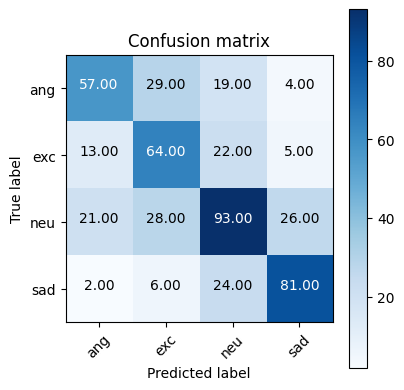

In [ ]:
print("[INFO] evaluating network...")
predictions = model_lstm_speech.predict(x=x_test_speech, batch_size=64)

print(classification_report(y_test_speech.argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(y_test_speech.argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

In [ ]:
model_deep_speech = construct_deep_model_speech()
model_deep_speech.summary()

hist_deep_speech = model_deep_speech.fit(x_train_speech, Y, 
                 batch_size=64, epochs=100, verbose=VERBOSE, shuffle = True, 
                 validation_split=0.1)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, 98, 1024)          105472    
_________________________________________________________________
dropout (Dropout)            (None, 98, 1024)          0         
_________________________________________________________________
flatten (Flatten)            (None, 100352)            0         
_________________________________________________________________
dense_1 (Dense)              (None, 1024)              102761472 
_________________________________________________________________
dropout_1 (Dropout)          (None, 1024)              0         
_________________________________________________________________
embedding_layer (Dense)      (None, 1024)              1049600   
_________________________________________________________________
dropout_2 (Dropout)          (None, 1024)             

[INFO] evaluating network...
              precision    recall  f1-score   support

         ang       0.21      0.27      0.24       109
         exc       0.23      0.15      0.18       104
         neu       0.31      0.35      0.33       168
         sad       0.27      0.24      0.25       113

    accuracy                           0.27       494
   macro avg       0.26      0.25      0.25       494
weighted avg       0.26      0.27      0.26       494



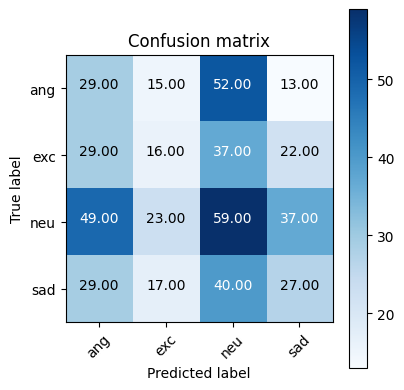

In [ ]:
print("[INFO] evaluating network...")
predictions = model_deep_speech.predict(x=x_test_speech, batch_size=64)

print(classification_report(y_test_speech.argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(y_test_speech.argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

In [ ]:
model_conv_speech = construct_conv_model_speech()

hist_conv_speech = model_conv_speech.fit(x_train_speech, Y, 
                 batch_size=64, epochs=100, verbose=VERBOSE, shuffle = True, 
                 validation_split=0.1)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_1 (Conv1D)            (None, 98, 1024)          105472    
_________________________________________________________________
dropout_3 (Dropout)          (None, 98, 1024)          0         
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 96, 512)           1573376   
_________________________________________________________________
dropout_4 (Dropout)          (None, 96, 512)           0         
_________________________________________________________________
conv1d_3 (Conv1D)            (None, 94, 256)           393472    
_________________________________________________________________
dropout_5 (Dropout)          (None, 94, 256)           0         
_________________________________________________________________
conv1d_4 (Conv1D)            (None, 92, 128)          

[INFO] evaluating network...
              precision    recall  f1-score   support

         ang       0.25      0.24      0.24       109
         exc       0.28      0.24      0.26       104
         neu       0.35      0.45      0.39       168
         sad       0.31      0.24      0.27       113

    accuracy                           0.31       494
   macro avg       0.30      0.29      0.29       494
weighted avg       0.30      0.31      0.30       494



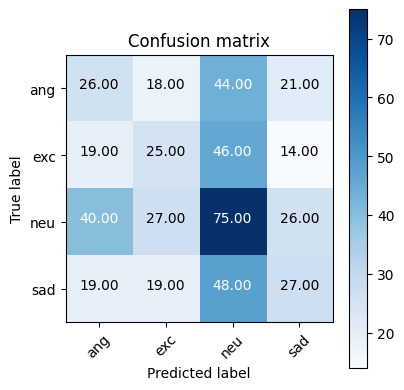

In [ ]:
print("[INFO] evaluating network...")
predictions = model_conv_speech.predict(x=x_test_speech, batch_size=64)

print(classification_report(y_test_speech.argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(y_test_speech.argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

In [ ]:
model_deep_text = construct_deep_model_text()


hist = model_deep_text.fit(x_train_text, y_train_text, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = model_deep_text.evaluate(x_test_text, y_test_text, verbose=1)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 500, 300)          821100    
_________________________________________________________________
conv1d_5 (Conv1D)            (None, 498, 1024)         922624    
_________________________________________________________________
dropout_8 (Dropout)          (None, 498, 1024)         0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 509952)            0         
_________________________________________________________________
dense_4 (Dense)              (None, 1024)              522191872 
_________________________________________________________________
dropout_9 (Dropout)          (None, 1024)              0         
_________________________________________________________________
embedding_layer (Dense)      (None, 1024)             

[INFO] evaluating network...
              precision    recall  f1-score   support

         ang       0.73      0.66      0.70       109
         exc       0.70      0.62      0.66       104
         neu       0.56      0.66      0.60       168
         sad       0.59      0.56      0.58       113

    accuracy                           0.63       494
   macro avg       0.65      0.62      0.63       494
weighted avg       0.64      0.63      0.63       494



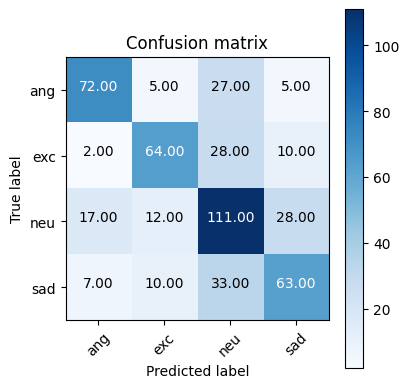

In [ ]:
print("[INFO] evaluating network...")
predictions = model_deep_text.predict(x=x_test_text, batch_size=64)
print(classification_report(y_test_text.argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(y_test_text.argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

In [ ]:
model_conv_text = construct_conv_model_text()


hist = model_conv_text.fit(x_train_text, y_train_text, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = model_conv_text.evaluate(x_test_text, y_test_text, verbose=1)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 500, 300)          821100    
_________________________________________________________________
conv1d_6 (Conv1D)            (None, 498, 1024)         922624    
_________________________________________________________________
dropout_11 (Dropout)         (None, 498, 1024)         0         
_________________________________________________________________
conv1d_7 (Conv1D)            (None, 496, 512)          1573376   
_________________________________________________________________
dropout_12 (Dropout)         (None, 496, 512)          0         
_________________________________________________________________
conv1d_8 (Conv1D)            (None, 494, 256)          393472    
_________________________________________________________________
dropout_13 (Dropout)         (None, 494, 256)         

[INFO] evaluating network...
              precision    recall  f1-score   support

         ang       0.58      0.76      0.66       109
         exc       0.69      0.58      0.63       104
         neu       0.57      0.54      0.55       168
         sad       0.66      0.61      0.63       113

    accuracy                           0.61       494
   macro avg       0.63      0.62      0.62       494
weighted avg       0.62      0.61      0.61       494



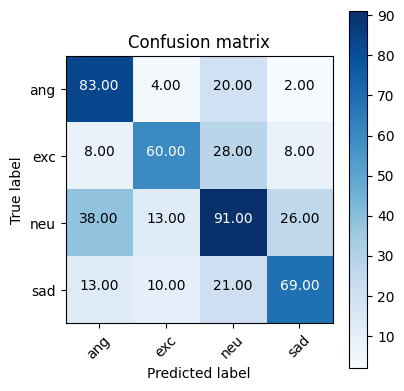

In [ ]:
print("[INFO] evaluating network...")
predictions = model_conv_text.predict(x=x_test_text, batch_size=64)
print(classification_report(y_test_text.argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(y_test_text.argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

In [ ]:
model_lstm_text = construct_lstm_model_text()

# callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=2, min_delta=0.02)


hist = model_lstm_text.fit(x_train_text, y_train_text, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = model_lstm_text.evaluate(x_test_text, y_test_text, verbose=1)

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 500, 300)          821100    
_________________________________________________________________
lstm_2 (LSTM)                (None, 500, 1024)         5427200   
_________________________________________________________________
lstm_3 (LSTM)                (None, 1024)              8392704   
_________________________________________________________________
embedding_layer (Dense)      (None, 1024)              1049600   
_________________________________________________________________
dense_7 (Dense)              (None, 4)                 4100      
Total params: 15,694,704
Trainable params: 15,694,704
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
63/63 [==============================] - 24s 335ms/step - loss: 1.3714 - acc: 0.3593 - val_loss:

[INFO] evaluating network...
              precision    recall  f1-score   support

         ang       0.64      0.70      0.67       109
         exc       0.71      0.64      0.68       104
         neu       0.58      0.62      0.60       168
         sad       0.65      0.59      0.62       113

    accuracy                           0.64       494
   macro avg       0.65      0.64      0.64       494
weighted avg       0.64      0.64      0.64       494



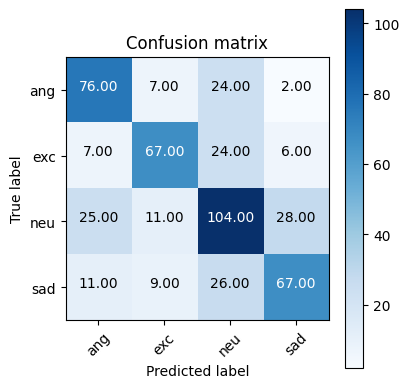

In [ ]:
print("[INFO] evaluating network...")
predictions = model_lstm_text.predict(x=x_test_text, batch_size=64)
print(classification_report(y_test_text.argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(y_test_text.argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

In [ ]:
extractor_lstm_speech = keras.Model(
    inputs=model_lstm_speech.inputs,
    outputs=model_lstm_speech.get_layer(name='embedding_layer').output,
)

extractor_lstm_text = keras.Model(
    inputs=model_lstm_text.inputs,
    outputs=model_lstm_text.get_layer(name="embedding_layer").output,
)

In [ ]:
extractor_deep_speech = keras.Model(
    inputs=model_deep_speech.inputs,
    outputs=model_deep_speech.get_layer(name='embedding_layer').output,
)

extractor_deep_text = keras.Model(
    inputs=model_deep_text.inputs,
    outputs=model_deep_text.get_layer(name="embedding_layer").output,
)

In [ ]:
extractor_conv_speech = keras.Model(
    inputs=model_conv_speech.inputs,
    outputs=model_conv_speech.get_layer(name='embedding_layer').output,
)

extractor_conv_text = keras.Model(
    inputs=model_conv_text.inputs,
    outputs=model_conv_text.get_layer(name="embedding_layer").output,
)

In [ ]:
from collections import defaultdict

axes = [0, 1, 2]
sizes = []
clusterK = 4

colors = ["tab:red", "tab:blue", "tab:green", "tab:orange",
          "tab:purple", "tab:olive", "tab:pink", "tab:cyan", "tab:gray"]
defaultcolor = "black"
defaultsize = 6

def plot2D(result, groups):
    fig = plt.figure(figsize=(40, 40))
    plt.scatter(result[:, axes[0]], result[:, axes[1]])
    for g, group in enumerate(groups):
        for label in group:
            i = embedding_labels.index(label)
            # Create plot point
            coord = (result[i, axes[0]], result[i, axes[1]])
            color = colors[g] if g < len(colors) else defaultcolor
            size = sizes[g] if g < len(sizes) else defaultsize
            plt.annotate(label, xy=coord, color=color, fontsize=size)


def plot3D(result, groups):
    fig = plt.figure(figsize=(40, 40))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(result[:, axes[0]], result[:, axes[1]], result[:, axes[2]])
    for g, group in enumerate(groups):
        for label in group:
            i = embedding_labels.index(label)
            # Create plot point
            color = colors[g] if g < len(colors) else defaultcolor
            size = sizes[g] if g < len(sizes) else defaultsize
            ax.text(result[i, axes[0]], result[i, axes[1]],
                    result[i, axes[2]], label, color=color, fontsize=size)
def get_groups_df(groups):

    table = np.zeros(shape=(5,4), dtype=int)

    index_map={'aa':0, 'ab':1, 'ba':2, 'bb':3, 'bc':4}

    for i, group in enumerate(groups):
        for combo_id in group:
            combo = combo_id[:2]
            table[index_map[combo], i] += 1

    df = pd.DataFrame(table, columns=['G'+ str(i) for i in range(1, 5)], index=['aa', 'ab', 'ba', 'bb', 'cb'])
    return df


def get_emotion_per_cell(groups):

    outtermost_dict = { 'G'+str(i) : dict()  for i in range(1,5) }

    for i, group in enumerate(groups):
        for combo_id in group:
            combo = combo_id[:2]
            prediction_index = combo_id[3]

            if combo not in outtermost_dict['G'+str(i+1)]:
                outtermost_dict['G'+str(i+1)][combo] = defaultdict(int)
            
            outtermost_dict['G'+str(i+1)][combo][prediction_index] += 1
        for label in ['aa', 'ba', 'ba', 'bb', 'bc']:
          if label not in outtermost_dict['G'+str(i+1)]:
                outtermost_dict['G'+str(i+1)][label] = defaultdict(int)


    return outtermost_dict


### Convolutional Implementation

In [ ]:
all_kclusters = dict()
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_conv_speech.predict(speech, batch_size=64)
text_embeddings = extractor_conv_text.predict(x_text, batch_size=64)
speech_predictions = model_conv_speech.predict(speech, batch_size=64)
text_predictions = model_conv_text.predict(x_text, batch_size=64)

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1

[['ba_3_2_3_173', 'ba_1_0_1_191', 'ba_1_2_1_192', 'ba_1_2_1_205', 'ba_1_2_1_208', 'ba_1_0_1_210', 'ba_1_3_1_213', 'ba_1_2_1_214', 'ba_1_0_1_215', 'ba_1_0_1_314', 'ba_1_2_1_327', 'aa_1_1_1_348', 'ba_1_2_1_372', 'ba_0_2_0_417', 'ba_1_3_1_480', 'ba_1_2_1_482', 'ba_1_2_1_485', 'ba_1_2_1_487', 'ba_1_0_1_490', 'ba_1_3_1_494', 'ba_1_2_1_508', 'ba_1_2_1_509', 'ba_1_0_1_516', 'ba_1_2_1_517', 'ba_1_2_1_522', 'aa_1_1_1_662', 'ba_1_2_1_669', 'ba_1_0_1_674', 'ba_1_2_1_679', 'ba_1_2_1_684', 'ba_1_2_1_685', 'ba_1_2_1_687', 'ba_1_2_1_688', 'ba_1_2_1_695', 'ba_1_2_1_816', 'ba_1_2_1_819', 'ba_1_2_1_824', 'ba_1_2_1_825', 'ba_1_2_1_831', 'ba_1_3_1_836', 'ba_1_2_1_839', 'aa_1_1_1_840', 'ba_1_3_1_841', 'ba_1_2_1_865', 'ba_1_2_1_898', 'aa_1_1_1_900', 'ba_1_2_1_985', 'ba_1_0_1_986', 'aa_1_1_1_987', 'ba_1_2_1_1092', 'ba_1_3_1_1093', 'aa_1_1_1_1098', 'ba_1_2_1_1100', 'ba_1_3_1_1106', 'ba_1_2_1_1107', 'ba_1_2_1_1109', 'ba_1_3_1_1114', 'aa_1_1_1_1115', 'ba_1_2_1_1124', 'ba_1_2_1_1135', 'ba_1_2_1_1253', 'ba_1_2_1_

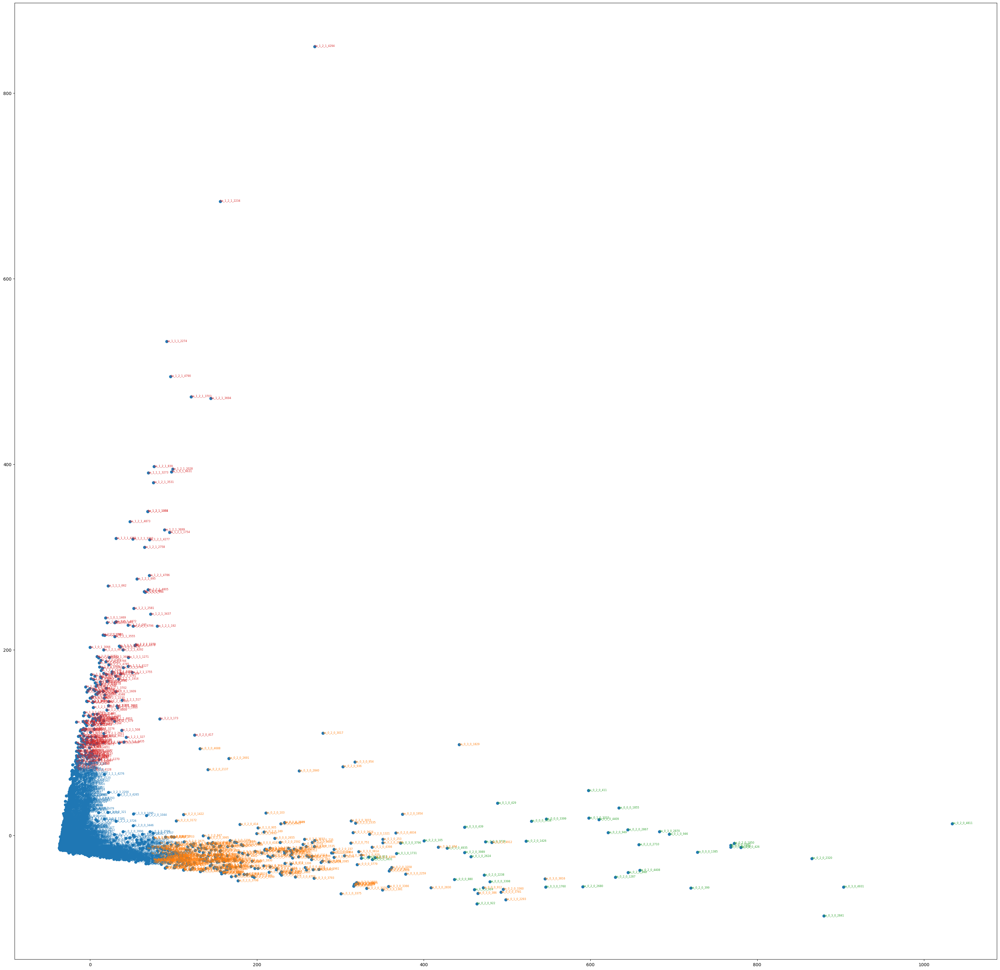

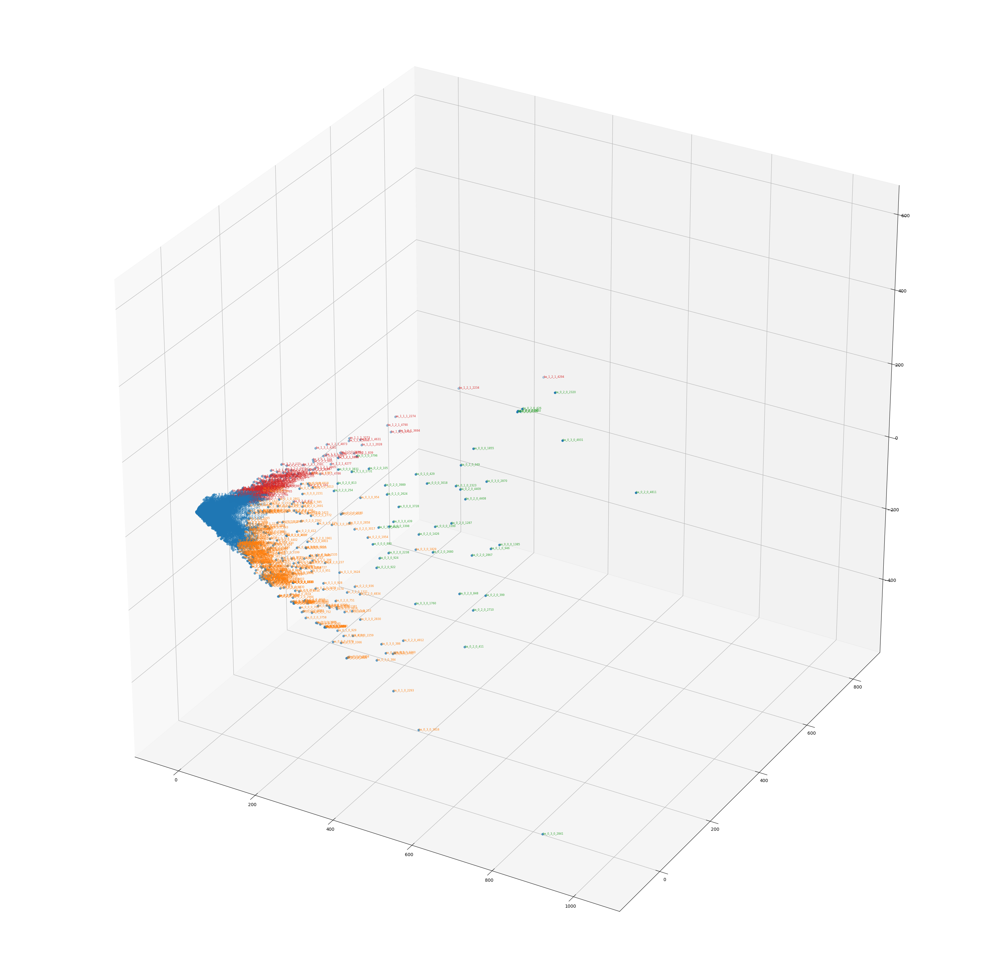

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['conv'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

### Deep Implementation

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_deep_speech.predict(speech, batch_size=64)
text_embeddings = extractor_deep_text.predict(x_text, batch_size=64)
speech_predictions = model_deep_speech.predict(speech, batch_size=64)
text_predictions = model_deep_text.predict(x_text, batch_size=64)

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1

[['aa_1_1_1_52', 'ba_1_2_1_192', 'ba_1_0_1_194', 'ba_1_2_1_198', 'aa_1_1_1_204', 'ba_1_2_1_205', 'ba_1_2_1_206', 'ba_1_3_1_207', 'ba_1_2_1_208', 'ba_1_2_1_210', 'ba_1_3_1_213', 'ba_1_3_1_214', 'ba_1_0_1_215', 'aa_3_3_3_282', 'ba_1_0_1_314', 'ba_1_2_1_326', 'ba_1_0_1_327', 'aa_1_1_1_328', 'ba_1_0_1_369', 'ba_1_3_1_372', 'ba_1_3_1_480', 'ba_1_2_1_482', 'ba_1_0_1_483', 'ba_1_2_1_484', 'ba_1_2_1_487', 'ba_1_0_1_490', 'ba_1_2_1_498', 'ba_1_2_1_499', 'ba_1_3_1_503', 'ba_1_2_1_506', 'ba_1_2_1_508', 'ba_1_0_1_516', 'ba_1_2_1_517', 'ba_1_2_1_522', 'aa_1_1_1_662', 'ba_1_2_1_665', 'ba_1_2_1_666', 'aa_1_1_1_667', 'ba_1_2_1_669', 'ba_1_2_1_679', 'ba_1_3_1_685', 'ba_1_2_1_687', 'ba_1_2_1_688', 'ba_1_2_1_689', 'aa_1_1_1_691', 'aa_1_1_1_695', 'aa_1_1_1_696', 'aa_1_1_1_816', 'ba_1_2_1_817', 'ba_1_2_1_818', 'ba_1_2_1_819', 'ba_1_0_1_824', 'aa_1_1_1_826', 'ba_1_0_1_831', 'ba_1_0_1_832', 'aa_1_1_1_835', 'ba_1_2_1_836', 'ba_1_3_1_837', 'ba_1_2_1_838', 'aa_1_1_1_840', 'ba_1_3_1_841', 'ba_1_2_1_865', 'ba_1_2

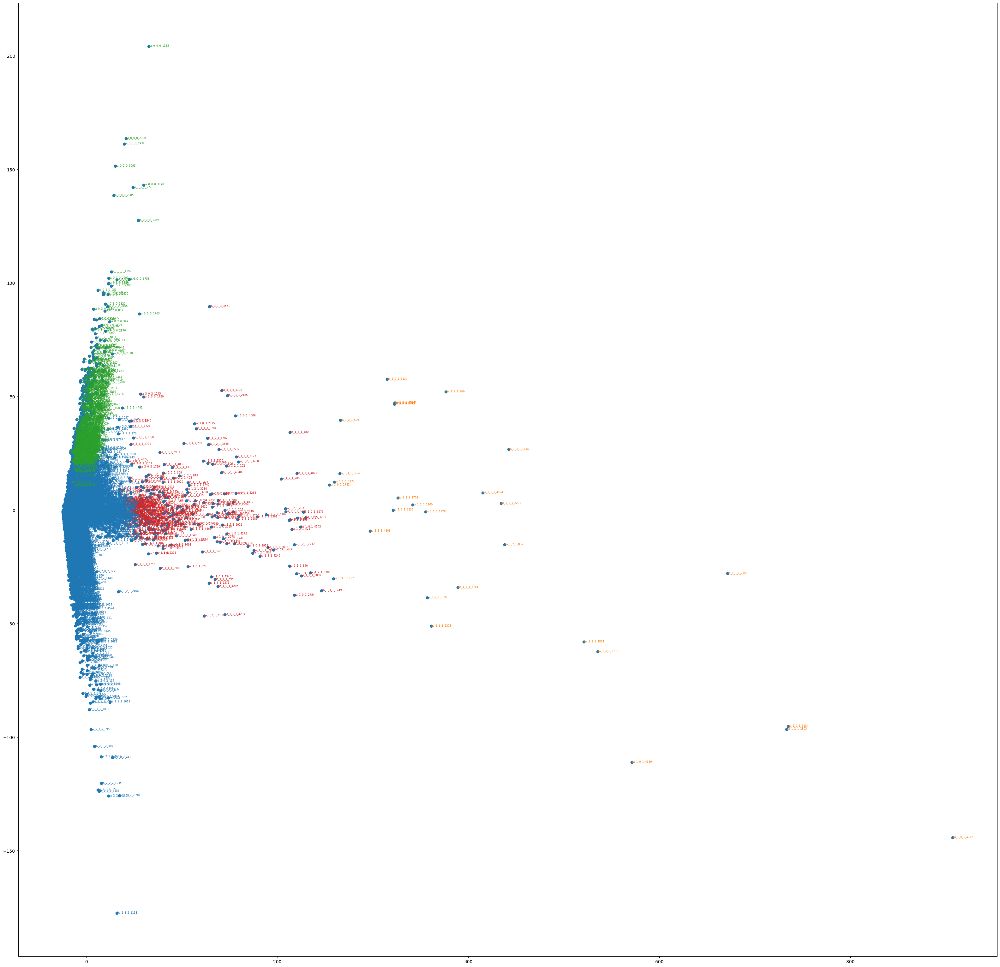

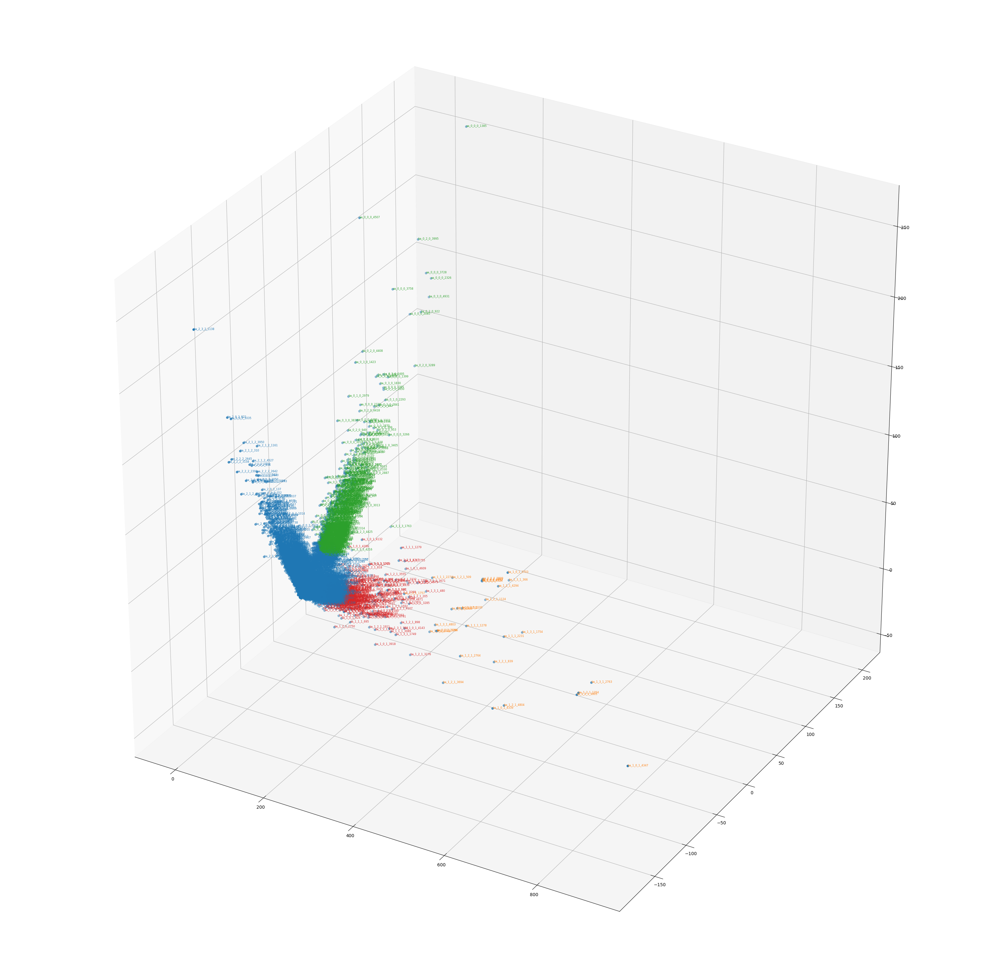

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['deep'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

### LSTM implementation

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_lstm_speech.predict(speech, batch_size=64)
text_embeddings = extractor_lstm_text.predict(x_text, batch_size=64)
speech_predictions = model_lstm_speech.predict(speech, batch_size=64)
text_predictions = model_lstm_text.predict(x_text, batch_size=64)

embeddings_train_lstm = []
embeddings_test_lstm = []
labels_train_lstm = []
labels_test_lstm = []

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding

  if len(total_embedding) == 1024 and len(prediction) == 4:
    if ind < (0.9*len(Y)):
      embeddings_train_lstm.append(total_embedding)
      labels_train_lstm.append(prediction)
    else:
      embeddings_test_lstm.append(total_embedding)
      labels_test_lstm.append(prediction)
  
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1


[['aa_0_0_0_4', 'aa_0_0_0_6', 'aa_0_0_0_7', 'ab_3_3_0_26', 'ab_3_3_0_29', 'ab_1_1_0_43', 'aa_0_0_0_62', 'aa_0_0_0_63', 'aa_0_0_0_66', 'aa_0_0_0_99', 'aa_0_0_0_100', 'aa_0_0_0_101', 'aa_0_0_0_102', 'aa_0_0_0_103', 'aa_0_0_0_104', 'aa_0_0_0_105', 'aa_0_0_0_107', 'aa_0_0_0_108', 'aa_0_0_0_110', 'aa_0_0_0_111', 'aa_0_0_0_113', 'aa_0_0_0_115', 'ba_0_2_0_116', 'aa_0_0_0_117', 'bc_2_3_0_132', 'ab_2_2_0_144', 'aa_0_0_0_220', 'aa_0_0_0_221', 'aa_0_0_0_222', 'aa_0_0_0_223', 'aa_0_0_0_224', 'bc_2_3_0_230', 'aa_0_0_0_237', 'aa_0_0_0_244', 'aa_0_0_0_245', 'aa_0_0_0_246', 'aa_0_0_0_247', 'aa_0_0_0_248', 'aa_0_0_0_249', 'aa_0_0_0_250', 'aa_0_0_0_251', 'aa_0_0_0_252', 'aa_0_0_0_253', 'aa_0_0_0_254', 'aa_0_0_0_258', 'aa_0_0_0_298', 'aa_0_0_0_299', 'aa_0_0_0_331', 'aa_0_0_0_332', 'aa_0_0_0_333', 'aa_0_0_0_334', 'ab_3_3_0_335', 'aa_0_0_0_336', 'aa_0_0_0_375', 'aa_0_0_0_377', 'aa_0_0_0_378', 'ba_0_2_0_379', 'aa_0_0_0_380', 'aa_0_0_0_381', 'aa_0_0_0_383', 'aa_0_0_0_384', 'aa_0_0_0_385', 'aa_0_0_0_386', 'ba

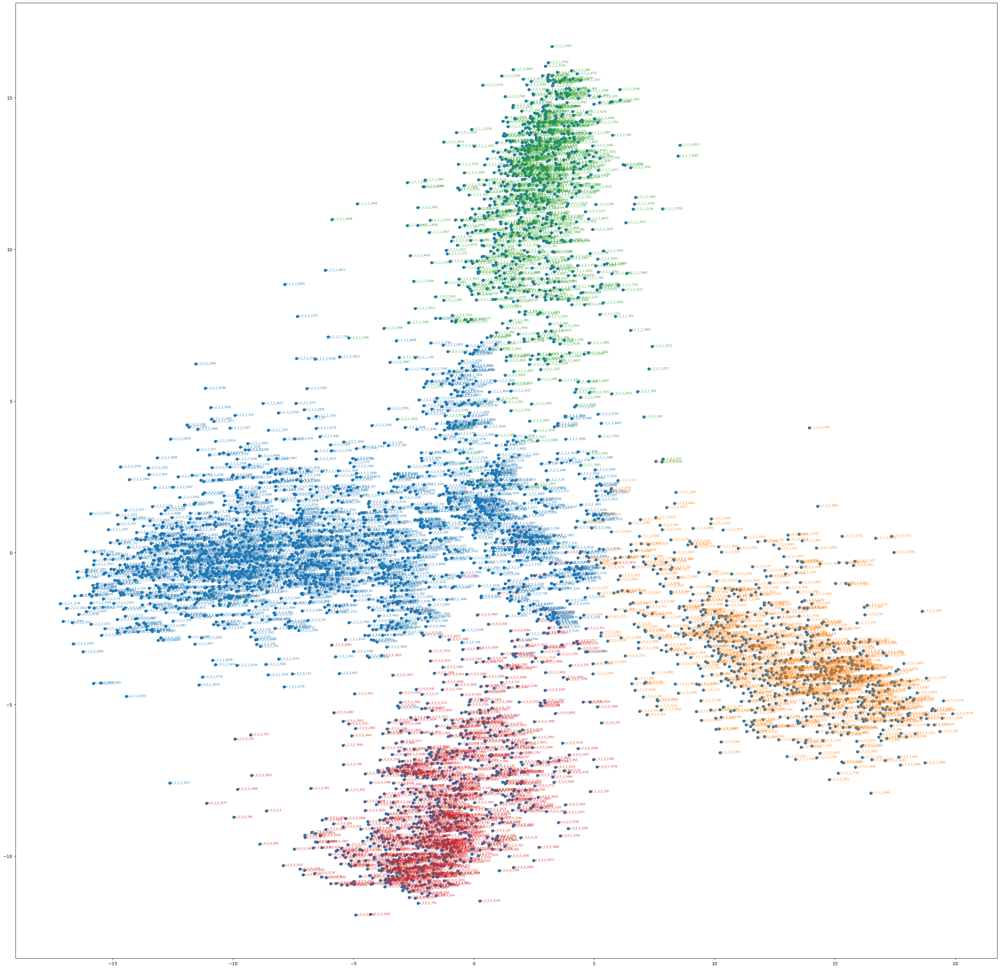

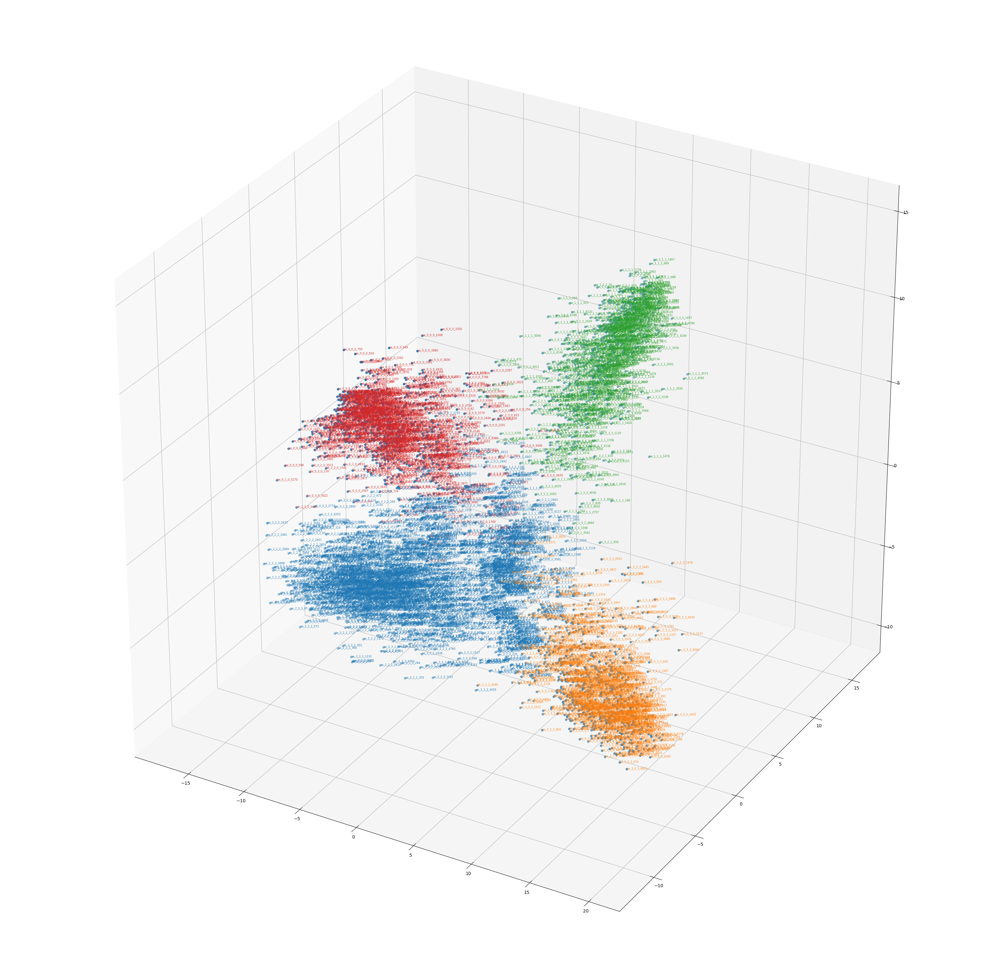

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['lstm'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

## Combined Implementation (Conv Speech + LSTM text)

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_conv_speech.predict(speech, batch_size=64)
text_embeddings = extractor_lstm_text.predict(x_text, batch_size=64)
speech_predictions = model_conv_speech.predict(speech, batch_size=64)
text_predictions = model_lstm_text.predict(x_text, batch_size=64)

embeddings_train_combined = []
embeddings_test_combined = []
labels_train_combined = []
labels_test_combined = []

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding
  if len(total_embedding) == 1024 and len(prediction) == 4:
    if ind < (0.9*len(Y)):
      embeddings_train_combined.append(total_embedding)
      labels_train_combined.append(prediction)
    else:
      embeddings_test_combined.append(total_embedding)
      labels_test_combined.append(prediction)
  
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1


[['ba_1_0_1_35', 'aa_1_1_1_52', 'bc_3_0_1_177', 'bc_2_0_1_179', 'bb_2_1_1_190', 'ba_1_0_1_191', 'ba_1_2_1_192', 'aa_1_1_1_193', 'ba_1_0_1_194', 'ba_1_2_1_195', 'ba_1_3_1_196', 'ba_1_2_1_198', 'ba_1_3_1_200', 'ba_1_3_1_201', 'ba_1_2_1_202', 'ba_1_3_1_203', 'aa_1_1_1_204', 'ba_1_2_1_205', 'aa_1_1_1_206', 'ba_1_3_1_207', 'ba_1_2_1_208', 'ba_1_3_1_209', 'ba_1_0_1_210', 'ba_1_3_1_213', 'ba_1_2_1_214', 'ba_1_0_1_215', 'ba_1_0_1_314', 'ba_1_2_1_326', 'ba_1_2_1_327', 'aa_1_1_1_328', 'aa_1_1_1_348', 'ba_1_3_1_366', 'ba_1_3_1_367', 'ba_1_0_1_369', 'ba_1_2_1_371', 'ba_1_2_1_372', 'ba_1_0_1_479', 'ba_1_3_1_480', 'ba_1_0_1_481', 'ba_1_2_1_482', 'ba_1_0_1_483', 'ba_1_2_1_484', 'ba_1_2_1_485', 'ba_1_2_1_487', 'ba_1_2_1_489', 'ba_1_0_1_490', 'ba_1_0_1_491', 'ba_1_3_1_494', 'aa_1_1_1_495', 'ba_1_2_1_498', 'ba_1_2_1_499', 'ba_1_2_1_500', 'ba_1_3_1_503', 'aa_1_1_1_505', 'ba_1_2_1_506', 'ba_1_2_1_508', 'ba_1_2_1_509', 'ba_1_2_1_510', 'ba_1_2_1_511', 'ba_1_0_1_513', 'ba_1_2_1_515', 'ba_1_0_1_516', 'ba_1_2_

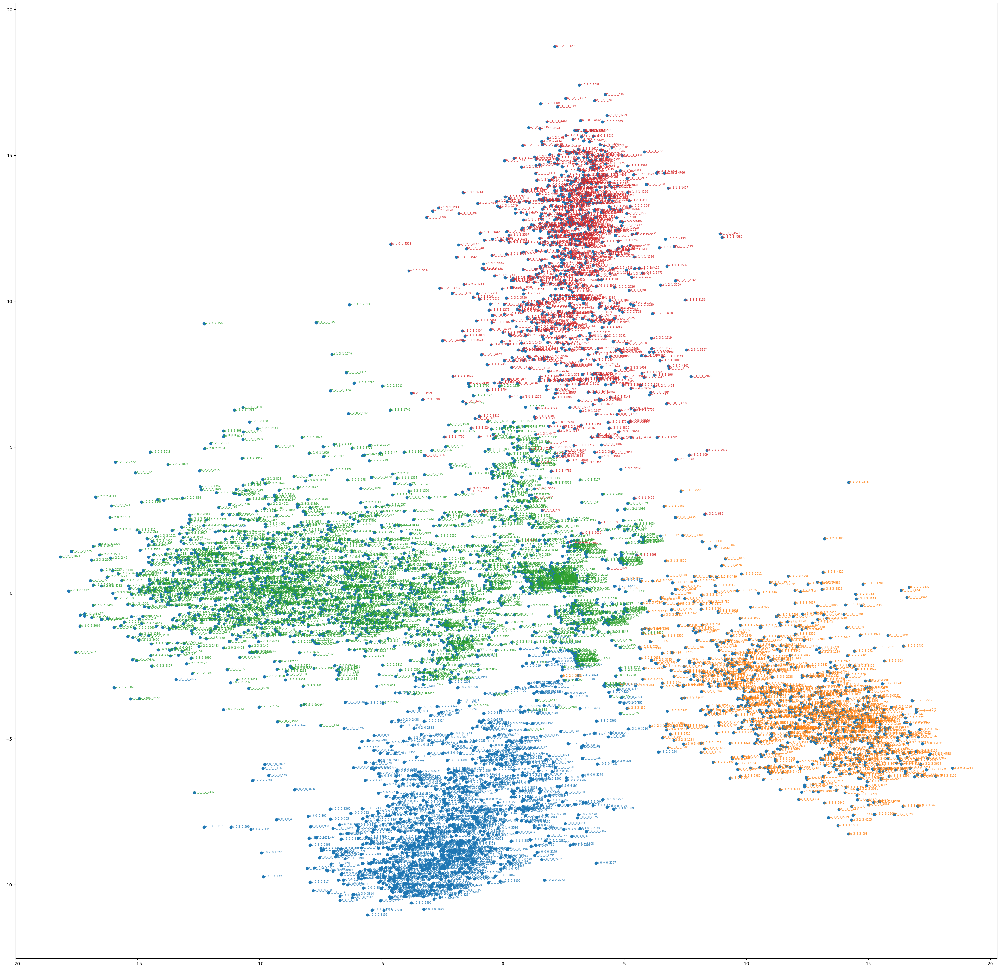

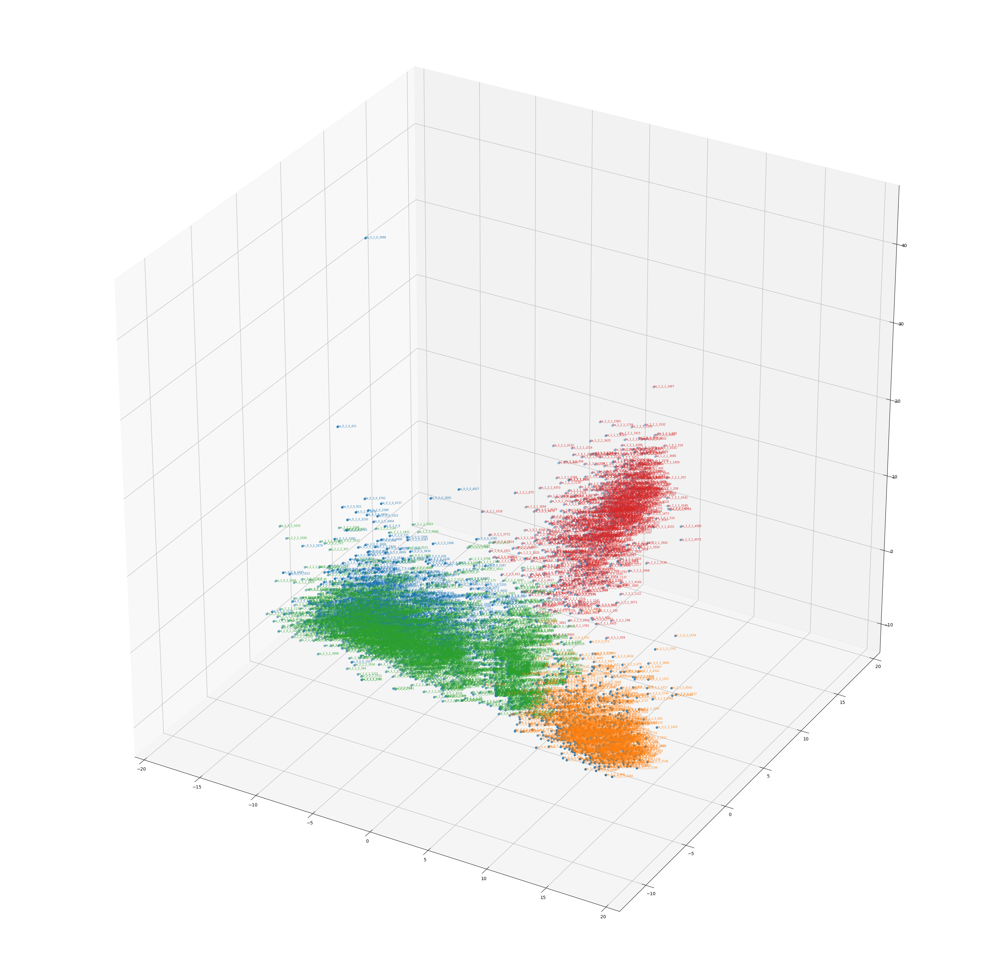

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['combined'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

## Combined 2 Implementation (Deep Speech + LSTM text)

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_deep_speech.predict(speech, batch_size=64)
text_embeddings = extractor_lstm_text.predict(x_text, batch_size=64)
speech_predictions = model_deep_speech.predict(speech, batch_size=64)
text_predictions = model_lstm_text.predict(x_text, batch_size=64)

embeddings_train_combined2 = []
embeddings_test_combined2 = []
labels_train_combined2 = []
labels_test_combined2 = []

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding

  if len(total_embedding) == 1024 and len(prediction) == 4:
    if ind < (0.9*len(Y)):
      embeddings_train_combined2.append(total_embedding)
      labels_train_combined2.append(prediction)
    else:
      embeddings_test_combined2.append(total_embedding)
      labels_test_combined2.append(prediction)
  
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1

[['ba_3_2_3_10', 'ba_3_1_3_15', 'ba_3_2_3_17', 'ba_3_0_3_18', 'aa_3_3_3_19', 'ba_3_2_3_20', 'aa_3_3_3_22', 'bb_2_3_3_23', 'aa_3_3_3_24', 'ba_3_2_3_25', 'aa_3_3_3_27', 'aa_3_3_3_28', 'ba_3_0_3_32', 'ba_3_1_3_33', 'ab_2_2_3_130', 'aa_3_3_3_151', 'ba_3_1_3_152', 'ba_3_0_3_153', 'bb_3_0_0_154', 'ba_3_2_3_156', 'ba_3_1_3_157', 'ba_3_2_3_158', 'aa_3_3_3_165', 'aa_3_3_3_166', 'ba_3_1_3_167', 'ba_3_1_3_169', 'aa_3_3_3_170', 'ba_3_0_3_171', 'ba_3_2_3_173', 'ba_3_0_3_174', 'ab_2_2_3_227', 'ab_2_2_3_262', 'ba_3_2_3_275', 'aa_3_3_3_282', 'ba_3_2_3_283', 'ba_3_0_3_284', 'ba_3_2_3_285', 'ba_3_2_3_286', 'ba_3_0_3_287', 'ba_3_1_3_288', 'ba_3_2_3_289', 'ba_3_0_3_290', 'ba_3_2_3_291', 'ba_3_1_3_292', 'ba_3_2_3_293', 'ba_3_0_3_294', 'ba_3_0_3_338', 'ba_3_2_3_341', 'ba_3_0_3_342', 'ba_3_0_3_344', 'ba_3_0_3_346', 'ba_3_0_3_359', 'ba_3_1_3_360', 'ba_3_0_3_450', 'ba_3_2_3_451', 'ba_3_1_3_452', 'ba_3_1_3_453', 'ba_3_0_3_454', 'aa_3_3_3_455', 'ba_3_2_3_457', 'ba_3_0_3_458', 'aa_3_3_3_459', 'aa_3_3_3_460', 'ba_

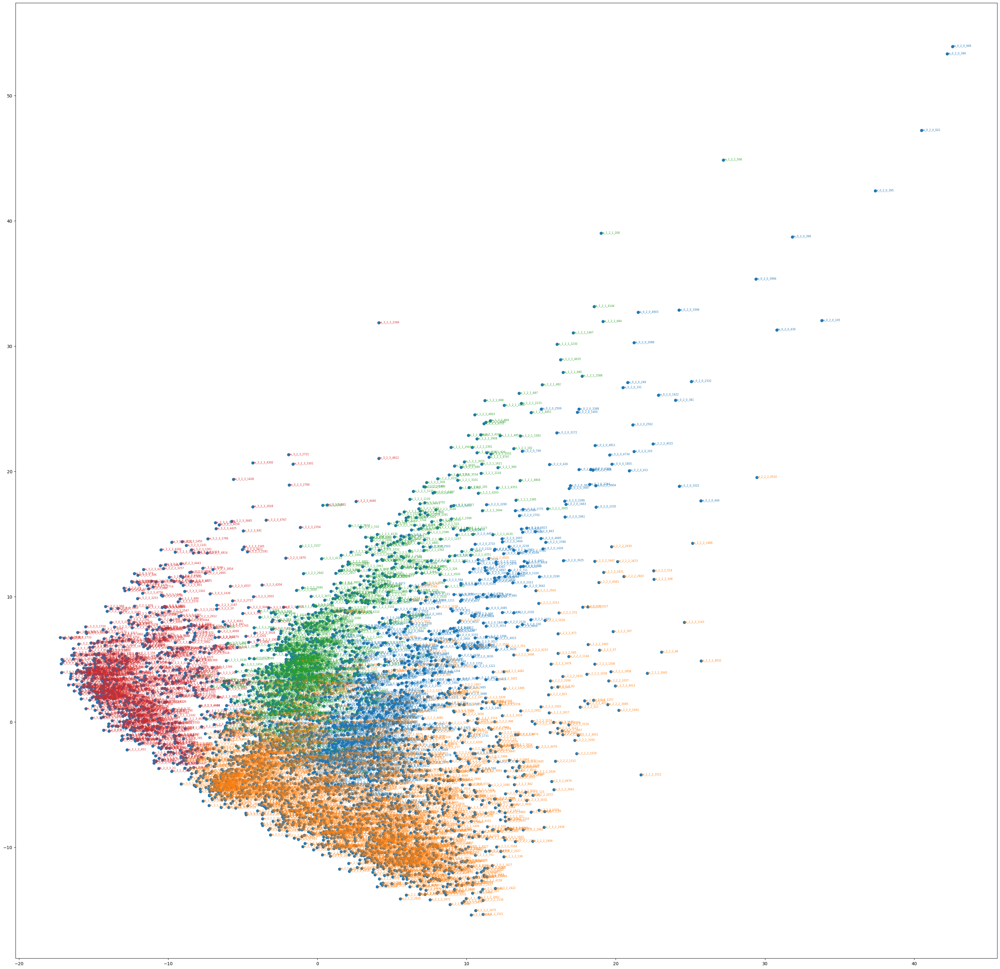

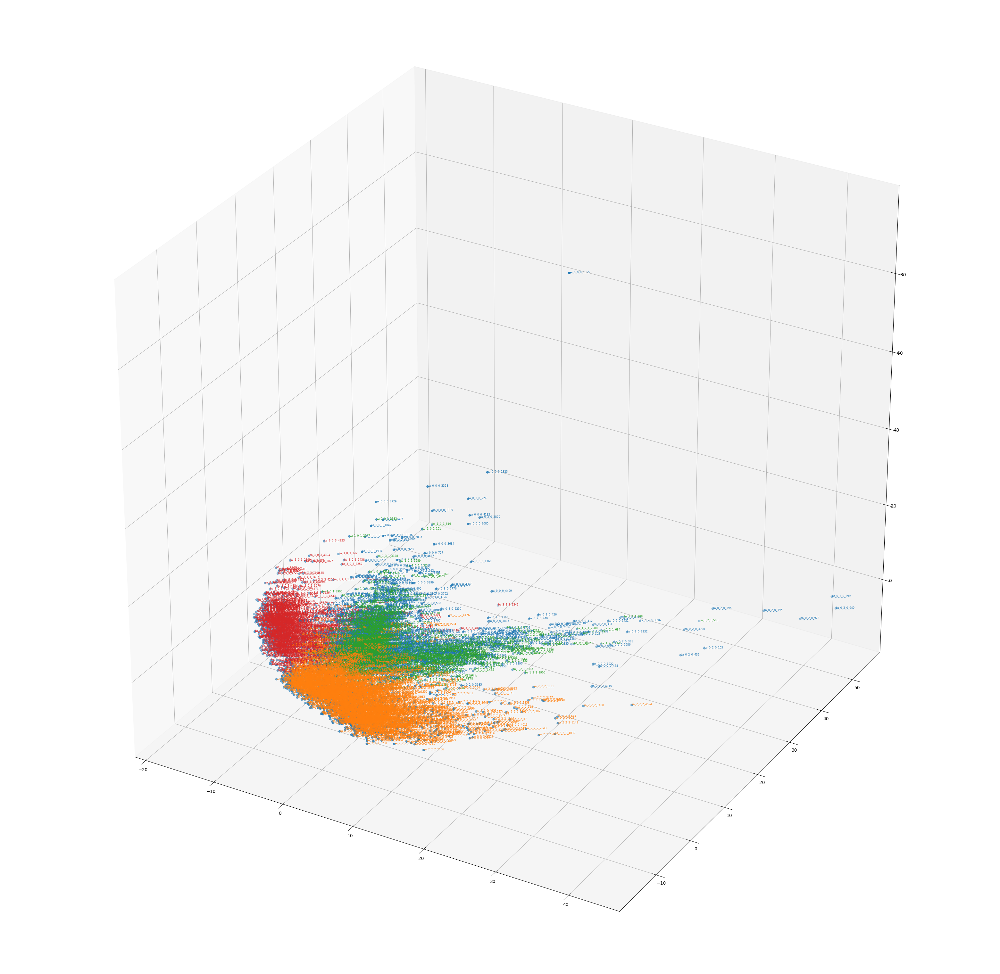

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['combined2'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

## Combined 3 Implementation (Deep Speech + Conv text)

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_deep_speech.predict(speech, batch_size=64)
text_embeddings = extractor_conv_text.predict(x_text, batch_size=64)
speech_predictions = model_deep_speech.predict(speech, batch_size=64)
text_predictions = model_conv_text.predict(x_text, batch_size=64)

embeddings_train_combined3 = []
embeddings_test_combined3 = []
labels_train_combined3 = []
labels_test_combined3 = []

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding

  if ind < (0.9*len(Y)):
    embeddings_train_combined3.append(total_embedding)
    labels_train_combined3.append(prediction)
  else:
    embeddings_test_combined3.append(total_embedding)
    labels_test_combined3.append(prediction)
  
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1

[['ba_3_2_3_173', 'ba_1_0_1_191', 'ba_1_2_1_192', 'ba_1_2_1_205', 'ba_1_2_1_208', 'ba_1_2_1_210', 'ba_1_3_1_213', 'ba_1_3_1_214', 'ba_1_0_1_215', 'ba_1_0_1_314', 'ba_1_0_1_327', 'ba_1_3_1_372', 'ba_0_2_0_417', 'ba_1_3_1_480', 'ba_1_2_1_482', 'aa_1_1_1_485', 'ba_1_2_1_487', 'ba_1_3_1_494', 'ba_1_2_1_508', 'ba_1_2_1_509', 'ba_1_0_1_516', 'ba_1_2_1_517', 'ba_1_2_1_522', 'aa_1_1_1_662', 'ba_1_2_1_669', 'ba_1_0_1_674', 'ba_1_2_1_679', 'ba_1_2_1_684', 'ba_1_3_1_685', 'ba_1_2_1_687', 'ba_1_2_1_688', 'aa_1_1_1_695', 'aa_1_1_1_816', 'ba_1_2_1_819', 'ba_1_0_1_824', 'ba_1_0_1_825', 'ba_1_0_1_831', 'ba_1_2_1_836', 'ba_1_2_1_839', 'aa_1_1_1_840', 'ba_1_3_1_841', 'ba_1_2_1_865', 'ba_1_2_1_898', 'aa_1_1_1_900', 'aa_1_1_1_985', 'ba_1_0_1_986', 'aa_1_1_1_987', 'ba_1_2_1_1092', 'ba_1_3_1_1093', 'aa_1_1_1_1098', 'ba_1_2_1_1100', 'ba_1_3_1_1106', 'ba_1_2_1_1107', 'ba_1_3_1_1114', 'aa_1_1_1_1115', 'ba_1_2_1_1124', 'ba_1_2_1_1135', 'ba_1_2_1_1253', 'ba_1_2_1_1258', 'ba_1_3_1_1263', 'ba_1_0_1_1265', 'ba_1_0_

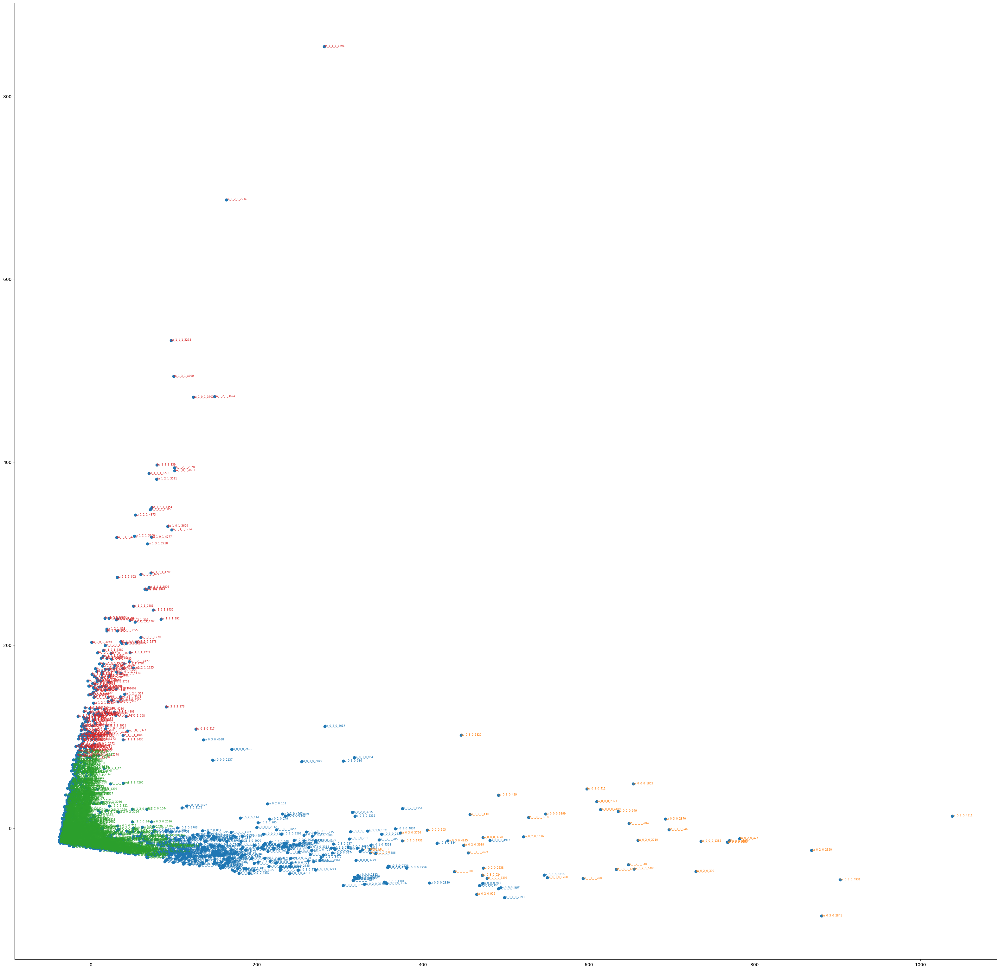

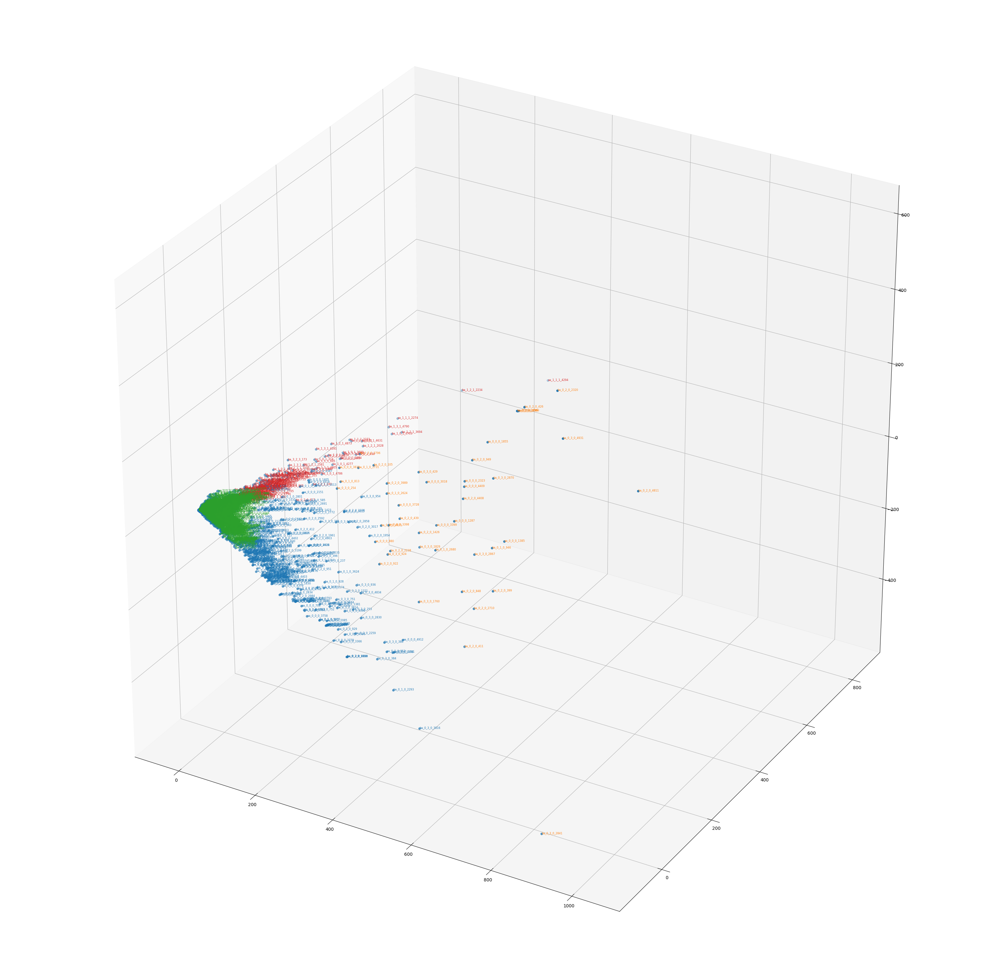

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['combined3'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

## Combined 4 Implementation (LSTM Speech + Conv text)

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_lstm_speech.predict(speech, batch_size=64)
text_embeddings = extractor_conv_text.predict(x_text, batch_size=64)
speech_predictions = model_lstm_speech.predict(speech, batch_size=64)
text_predictions = model_conv_text.predict(x_text, batch_size=64)

embeddings_train_combined4 = []
embeddings_test_combined4 = []
labels_train_combined4 = []
labels_test_combined4 = []

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding

  if ind < (0.9*len(Y)):
    embeddings_train_combined4.append(total_embedding)
    labels_train_combined4.append(prediction)
  else:
    embeddings_test_combined4.append(total_embedding)
    labels_test_combined4.append(prediction)
  
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1

[['aa_3_3_3_173', 'aa_1_1_1_191', 'aa_1_1_1_192', 'aa_1_1_1_205', 'aa_1_1_1_208', 'ba_1_2_1_210', 'aa_1_1_1_213', 'aa_1_1_1_214', 'aa_1_1_1_215', 'aa_1_1_1_314', 'aa_1_1_1_327', 'aa_1_1_1_348', 'aa_1_1_1_372', 'ba_0_1_0_417', 'aa_1_1_1_480', 'aa_1_1_1_482', 'aa_1_1_1_485', 'aa_1_1_1_487', 'aa_1_1_1_494', 'aa_1_1_1_508', 'aa_1_1_1_509', 'aa_1_1_1_516', 'aa_1_1_1_517', 'aa_1_1_1_522', 'aa_1_1_1_662', 'aa_1_1_1_669', 'aa_1_1_1_674', 'aa_1_1_1_679', 'aa_1_1_1_684', 'aa_1_1_1_685', 'aa_1_1_1_687', 'aa_1_1_1_688', 'aa_1_1_1_695', 'aa_1_1_1_816', 'aa_1_1_1_819', 'aa_1_1_1_824', 'aa_1_1_1_825', 'aa_1_1_1_831', 'aa_1_1_1_836', 'aa_1_1_1_839', 'aa_1_1_1_840', 'aa_1_1_1_841', 'aa_1_1_1_865', 'aa_1_1_1_898', 'aa_1_1_1_900', 'aa_1_1_1_985', 'aa_1_1_1_986', 'aa_1_1_1_987', 'aa_1_1_1_1092', 'aa_1_1_1_1093', 'aa_1_1_1_1098', 'aa_1_1_1_1100', 'aa_1_1_1_1106', 'aa_1_1_1_1107', 'aa_1_1_1_1114', 'aa_1_1_1_1115', 'aa_1_1_1_1124', 'aa_1_1_1_1135', 'aa_1_1_1_1253', 'aa_1_1_1_1258', 'aa_1_1_1_1263', 'aa_1_1_1

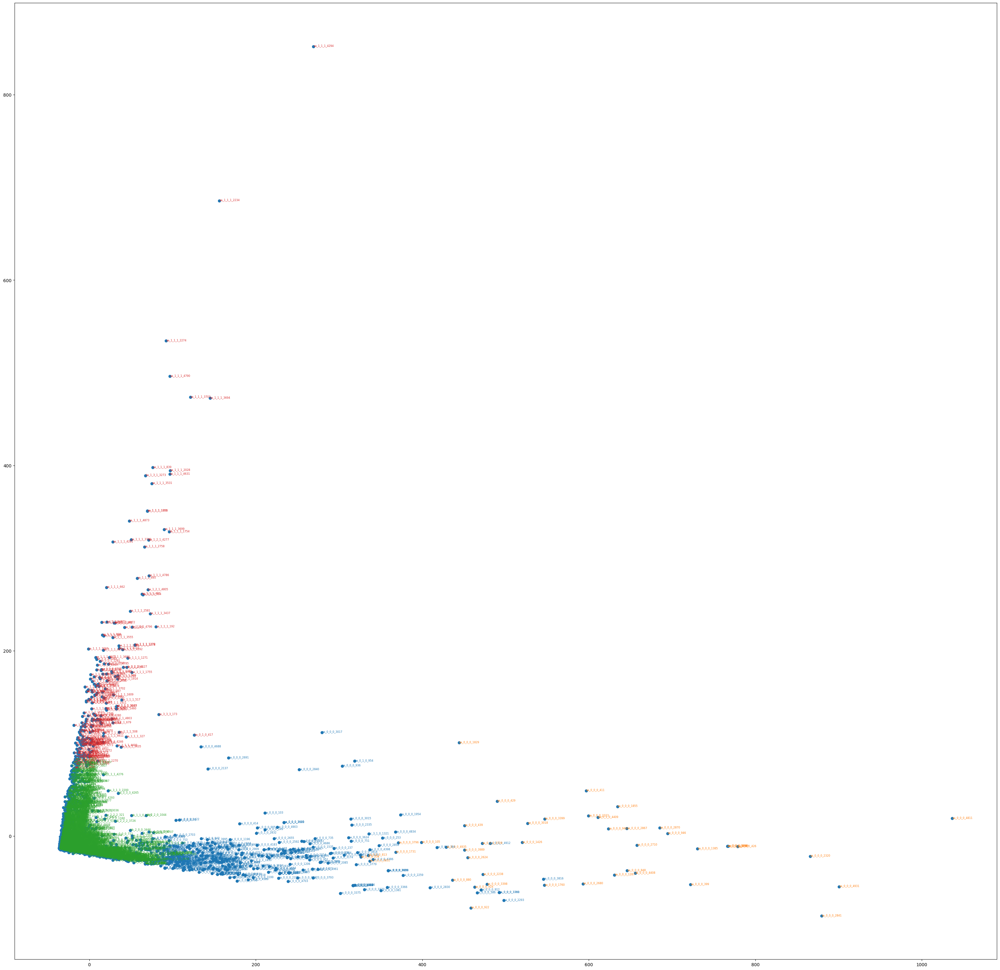

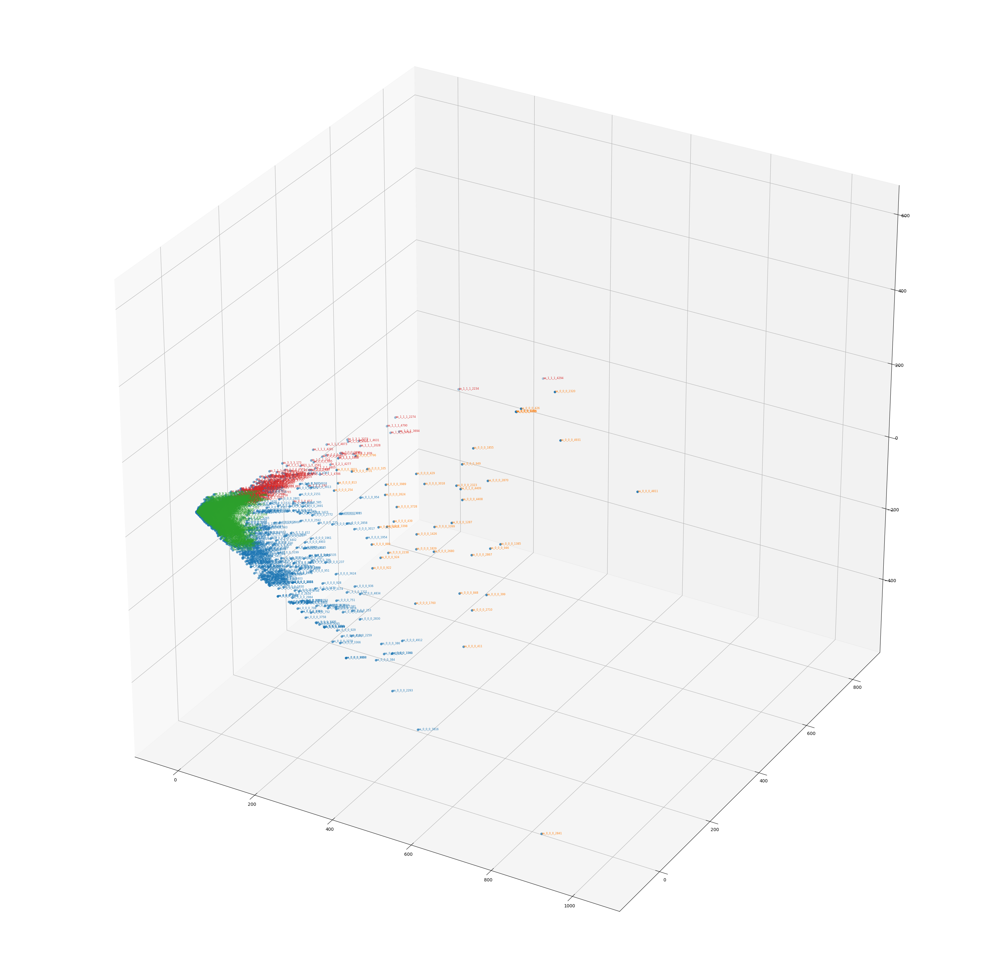

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['combined4'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

## Combined 5 Implementation (LSTM speech + Deep text)

In [ ]:
# aa = same prediciton and prediction is correct
# bb = same prediction, none correct
# ab = different prediction, speech is correct
# ba = different predictions, text is correct
# bc = different predictions, none correct
aa = []
ab = []
ba = []
bb = []
bc = []

all_embeddings = []
embedding_labels = []
i = 0

speech_embeddings = extractor_lstm_speech.predict(speech, batch_size=64)
text_embeddings = extractor_deep_text.predict(x_text, batch_size=64)
speech_predictions = model_lstm_speech.predict(speech, batch_size=64)
text_predictions = model_deep_text.predict(x_text, batch_size=64)

embeddings_train_combined5 = []
embeddings_test_combined5 = []
labels_train_combined5 = []
labels_test_combined5 = []

for ind in range(len(Y)):
  text_prediction = text_predictions[i]
  speech_prediction = speech_predictions[i]
  prediction = Y[i]
  speech_embedding = speech_embeddings[i]
  text_embedding = text_embeddings[i]
  total_embedding = speech_embedding + text_embedding

  if ind < (0.9*len(Y)):
    embeddings_train_combined5.append(total_embedding)
    labels_train_combined5.append(prediction)
  else:
    embeddings_test_combined5.append(total_embedding)
    labels_test_combined5.append(prediction)
  
  speech_index = speech_prediction.argmax(axis=0)
  text_index = text_prediction.argmax(axis=0)
  prediction_index = prediction.argmax(axis=0)
  label = ''

  if speech_index == text_index:
    if speech_index == prediction_index:
      aa.append(total_embedding)
      label = 'aa_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bb.append(total_embedding)
      label = 'bb_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
  else:
    if speech_index == prediction_index:
      ab.append(total_embedding)
      label = 'ab_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    elif text_index == prediction_index:
      ba.append(total_embedding)
      label = 'ba_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)
    else:
      bc.append(total_embedding)
      label = 'bc_'+str(prediction_index)+'_'+str(speech_index)+'_'+str(text_index)+'_'+str(i)

  all_embeddings.append(total_embedding)
  embedding_labels.append(label)
  i+=1

[['aa_2_2_2_0', 'aa_2_2_2_1', 'aa_2_2_2_2', 'aa_2_2_2_3', 'ab_0_0_2_4', 'aa_2_2_2_5', 'aa_0_0_0_6', 'ab_3_3_2_8', 'aa_3_3_3_9', 'aa_3_3_3_10', 'aa_2_2_2_11', 'aa_3_3_3_12', 'aa_3_3_3_13', 'aa_2_2_2_14', 'aa_3_3_3_15', 'ab_3_3_0_16', 'aa_3_3_3_17', 'aa_3_3_3_18', 'aa_3_3_3_19', 'aa_3_3_3_20', 'aa_2_2_2_21', 'aa_3_3_3_22', 'bb_2_3_3_23', 'aa_3_3_3_24', 'aa_3_3_3_25', 'aa_3_3_3_26', 'aa_3_3_3_27', 'aa_3_3_3_28', 'aa_3_3_3_29', 'ab_3_3_2_30', 'aa_2_2_2_31', 'aa_3_3_3_32', 'aa_3_3_3_33', 'ab_2_2_3_34', 'aa_1_1_1_35', 'aa_2_2_2_36', 'aa_2_2_2_37', 'aa_2_2_2_38', 'aa_2_2_2_39', 'aa_2_2_2_40', 'aa_2_2_2_41', 'aa_2_2_2_42', 'ab_1_1_3_43', 'aa_2_2_2_44', 'aa_2_2_2_45', 'aa_2_2_2_46', 'aa_2_2_2_47', 'aa_2_2_2_48', 'aa_2_2_2_49', 'aa_2_2_2_50', 'aa_2_2_2_51', 'aa_2_2_2_53', 'aa_2_2_2_54', 'aa_2_2_2_55', 'aa_2_2_2_56', 'aa_2_2_2_57', 'aa_2_2_2_58', 'aa_2_2_2_59', 'aa_2_2_2_60', 'bc_0_2_3_61', 'aa_0_0_0_62', 'ab_0_0_2_65', 'aa_0_0_0_66', 'aa_2_2_2_67', 'aa_2_2_2_68', 'ba_2_3_2_69', 'aa_2_2_2_70', 'a

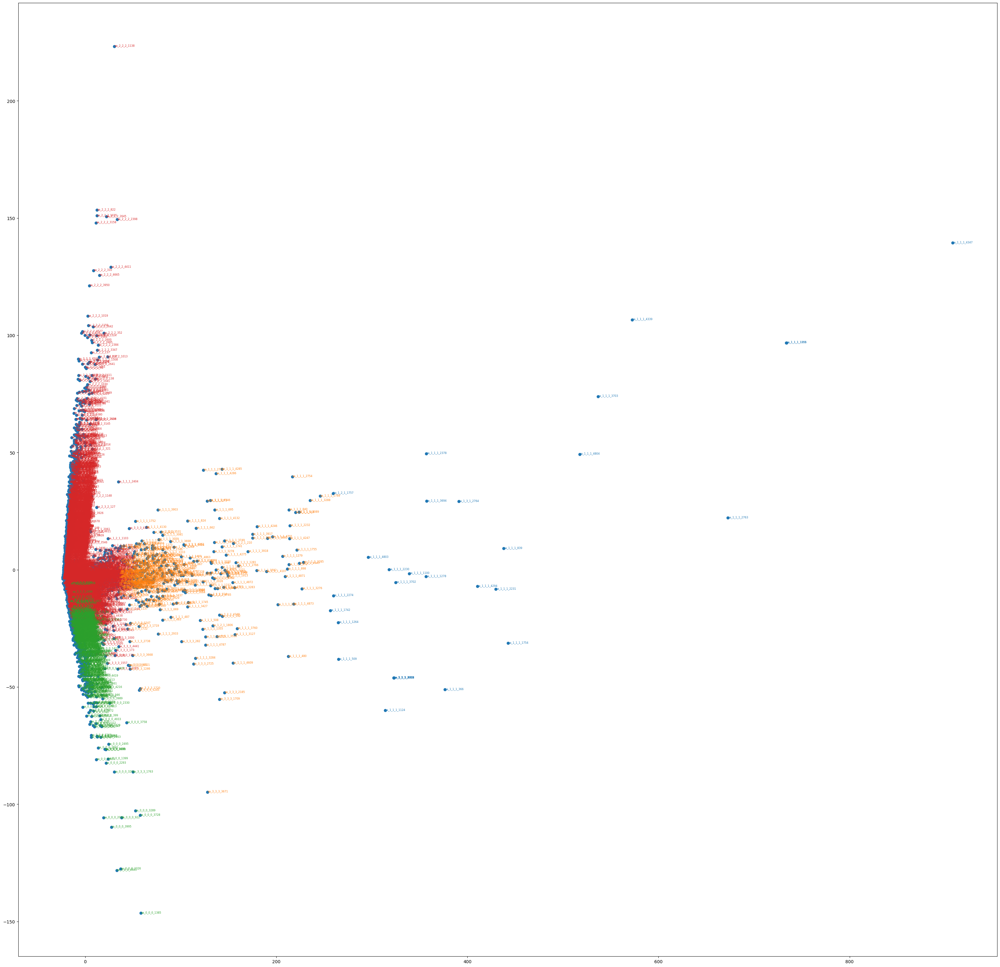

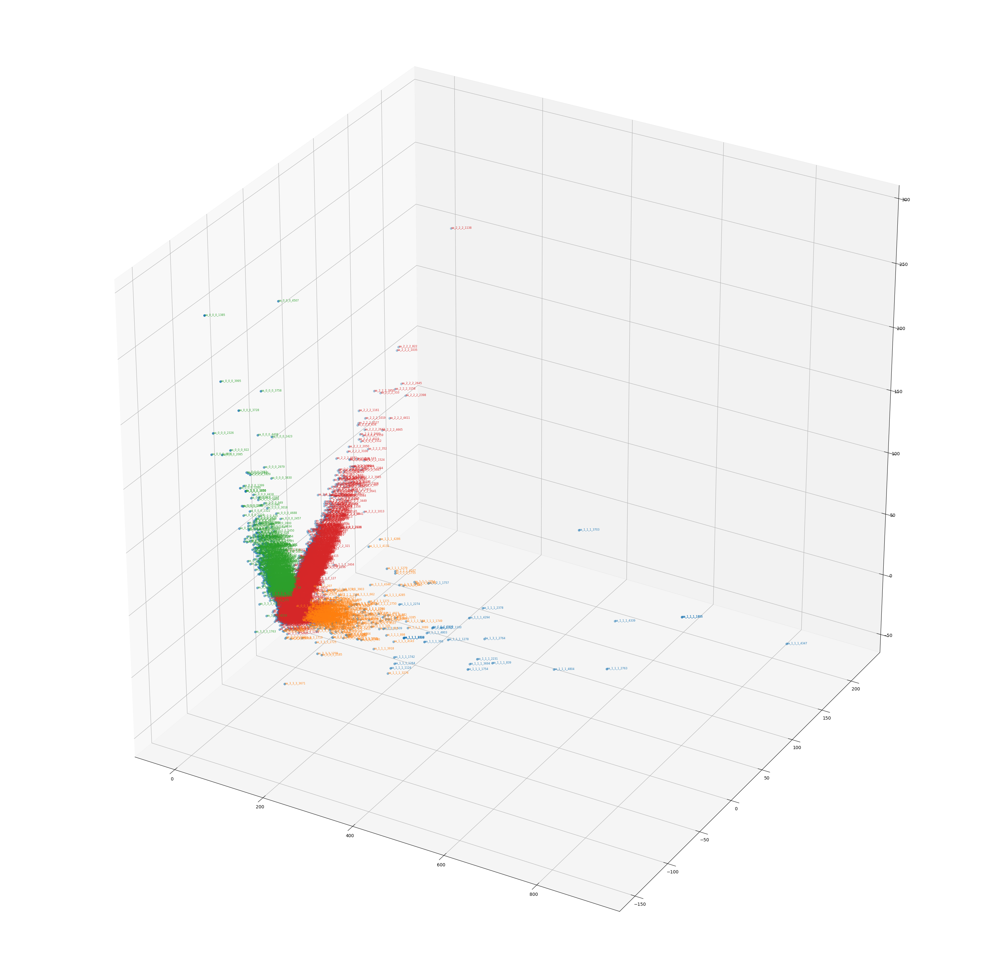

In [ ]:
estimator = KMeans(init='k-means++', n_clusters=clusterK, n_init=10)
estimator.fit_predict(all_embeddings)
groups = [[] for n in range(clusterK)]
for i, w in enumerate(embedding_labels):
  group = estimator.labels_[i]
  groups[group].append(w)

print(groups)
all_kclusters['combined5'] = groups

pca = PCA(n_components = max(axes)+1)
result = pca.fit_transform(all_embeddings)

plot2D(result, groups)
plot3D(result, groups)

## Clustering

conv
     G1    G2  G3   G4
aa   28  1024  10   60
ab    0   158   0    2
ba  206  2693  34  294
bb    0   156   0    1
cb    0   268   0    2



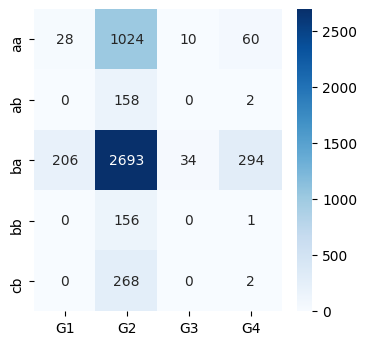

deep
     G1    G2   G3  G4
aa   72   854  156   6
ab    1   135    1   0
ba  309  2399  541  24
bb    0   162    2   0
cb    2   270    2   0



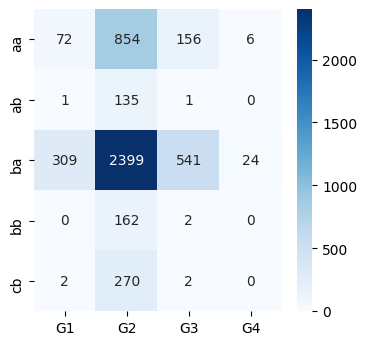

lstm
     G1    G2   G3   G4
aa  899  1586  820  824
ab   33   311   33   22
ba   61   131   45   25
bb   10    33    8    9
cb   14    41   11   20



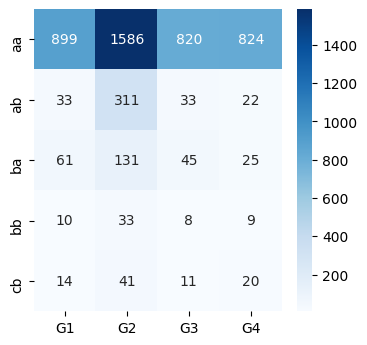

combined
     G1   G2    G3   G4
aa  146  194   616  166
ab    9   16   115   20
ba  717  763  1116  673
bb   12   12   113    9
cb   32   33   149   25



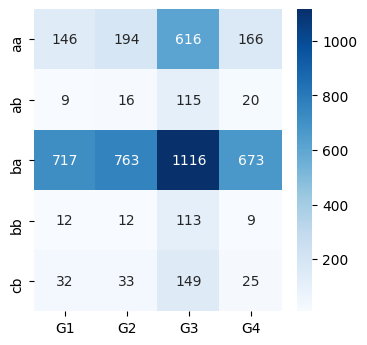

combined2
     G1   G2   G3    G4
aa  175  208  150   549
ab   11   14   14   104
ba  663  743  706  1197
bb   19   12    7   100
cb   28   25   27   184



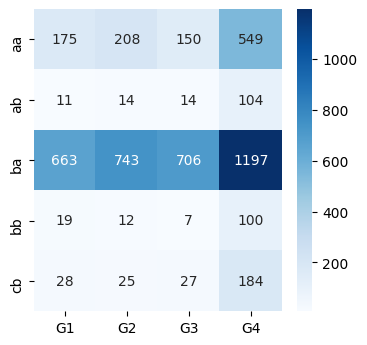

combined3
     G1   G2    G3  G4
aa   41   77   954  13
ab    0    2   138   0
ba  180  282  2770  32
bb    0    2   183   0
cb    0    1   261   0



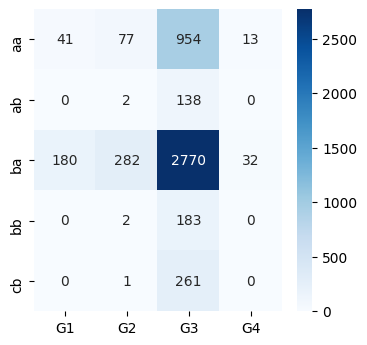

combined4
     G1   G2    G3  G4
aa  212  339  3511  44
ab    0    0   422   0
ba   13   17   212   1
bb    0    3    62   0
cb    0    2    98   0



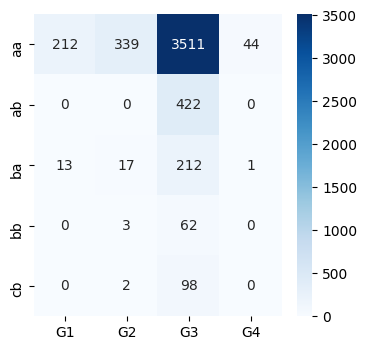

combined5
      G1  G2   G3   G4
aa  3056  28  666  367
ab   407   0    2    2
ba   197   2   33   12
bb    64   0    2    1
cb    95   0    2    0



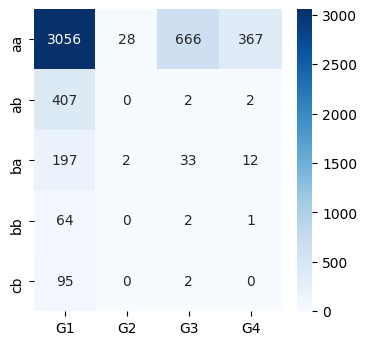

In [ ]:
for type_of_group in all_kclusters.keys():
    groups = all_kclusters[type_of_group]
    df = get_groups_df(groups)
    print(type_of_group)
    print(df)
    print()
    sns.heatmap(df, annot=True, cmap='Blues', fmt='g')
    plt.show()


## LSTM Example

{'G1': {'aa': defaultdict(<class 'int'>, {'0': 899}), 'ab': defaultdict(<class 'int'>, {'3': 13, '1': 4, '2': 15, '0': 1}), 'ba': defaultdict(<class 'int'>, {'0': 61}), 'bc': defaultdict(<class 'int'>, {'2': 11, '3': 2, '1': 1}), 'bb': defaultdict(<class 'int'>, {'2': 6, '3': 2, '1': 2})}, 'G2': {'aa': defaultdict(<class 'int'>, {'2': 1390, '3': 89, '1': 55, '0': 52}), 'ab': defaultdict(<class 'int'>, {'3': 88, '2': 114, '0': 40, '1': 69}), 'bb': defaultdict(<class 'int'>, {'0': 9, '3': 7, '2': 8, '1': 9}), 'ba': defaultdict(<class 'int'>, {'2': 98, '0': 11, '3': 10, '1': 12}), 'bc': defaultdict(<class 'int'>, {'2': 14, '1': 9, '0': 12, '3': 6})}, 'G3': {'aa': defaultdict(<class 'int'>, {'1': 820}), 'ab': defaultdict(<class 'int'>, {'3': 10, '2': 14, '1': 3, '0': 6}), 'bb': defaultdict(<class 'int'>, {'2': 4, '0': 4}), 'bc': defaultdict(<class 'int'>, {'2': 6, '3': 3, '0': 2}), 'ba': defaultdict(<class 'int'>, {'1': 44, '3': 1})}, 'G4': {'aa': defaultdict(<class 'int'>, {'3': 824}), 'b

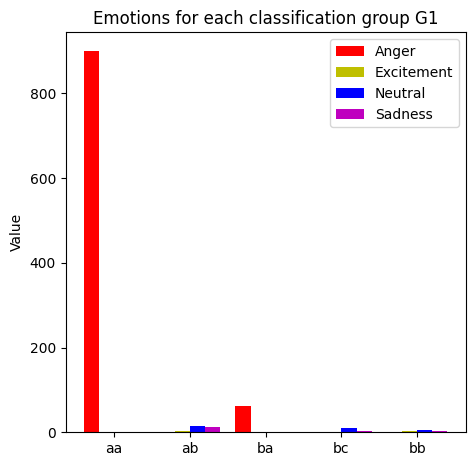

[52, 40, 9, 11, 12]


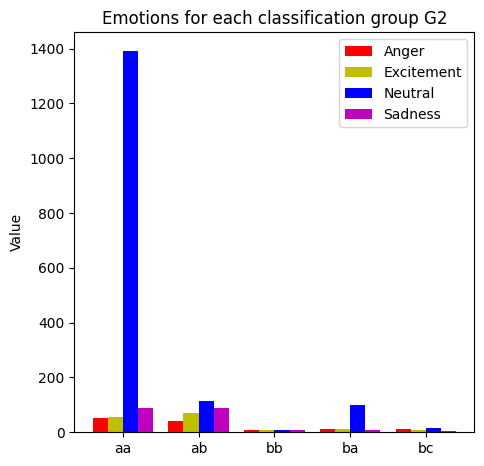

[0, 6, 4, 2, 0]


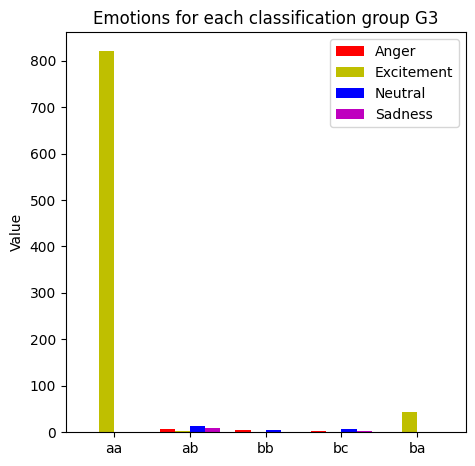

[0, 1, 5, 0, 0]


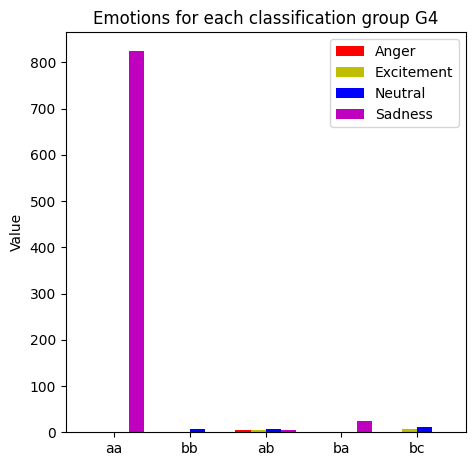

In [ ]:
test_group = all_kclusters['lstm']
emotions_of_interest = get_emotion_per_cell(test_group)

print(emotions_of_interest)

for group_name in emotions_of_interest.keys():
  labels = []
  anger = []
  excitement = []
  neutral = []
  sadness = []
  group_dict = emotions_of_interest[group_name]
  X = np.arange(len(group_dict.keys()))
  fig = plt.figure()
  ax = fig.add_axes([0,0,1,1])
  for key in group_dict.keys():
    labels.append(key)
    anger.append(group_dict[key]['0'])
    excitement.append(group_dict[key]['1'])
    neutral.append(group_dict[key]['2'])
    sadness.append(group_dict[key]['3'])
  
  print(anger)

  ax.bar(X - 0.30, anger, color = 'r', width = 0.2)
  ax.bar(X - 0.10, excitement, color = 'y', width = 0.2)
  ax.bar(X + 0.10, neutral, color = 'b', width = 0.2)
  ax.bar(X + 0.30, sadness, color = 'm', width = 0.2)

  ax.set_ylabel('Value')
  ax.set_title('Emotions for each classification group ' + group_name)
  ax.set_xticks(X)
  ax.set_xticklabels(labels)
  ax.legend(labels=['Anger', 'Excitement', 'Neutral', 'Sadness'])
  plt.show()



## Combined Example

{'G1': {'ba': defaultdict(<class 'int'>, {'1': 716, '3': 1}), 'aa': defaultdict(<class 'int'>, {'1': 146}), 'bc': defaultdict(<class 'int'>, {'3': 9, '2': 16, '0': 7}), 'bb': defaultdict(<class 'int'>, {'2': 5, '3': 4, '1': 1, '0': 2}), 'ab': defaultdict(<class 'int'>, {'2': 5, '0': 3, '3': 1})}, 'G2': {'ba': defaultdict(<class 'int'>, {'0': 763}), 'bb': defaultdict(<class 'int'>, {'3': 2, '2': 8, '1': 2}), 'bc': defaultdict(<class 'int'>, {'3': 16, '1': 5, '2': 11, '0': 1}), 'aa': defaultdict(<class 'int'>, {'0': 194}), 'ab': defaultdict(<class 'int'>, {'2': 13, '3': 2, '1': 1})}, 'G3': {'aa': defaultdict(<class 'int'>, {'2': 569, '3': 21, '0': 15, '1': 11}), 'ba': defaultdict(<class 'int'>, {'2': 919, '3': 88, '1': 58, '0': 51}), 'bb': defaultdict(<class 'int'>, {'3': 42, '1': 26, '2': 21, '0': 24}), 'bc': defaultdict(<class 'int'>, {'3': 34, '2': 54, '0': 23, '1': 38}), 'ab': defaultdict(<class 'int'>, {'0': 14, '2': 54, '3': 25, '1': 22})}, 'G4': {'ba': defaultdict(<class 'int'>, {

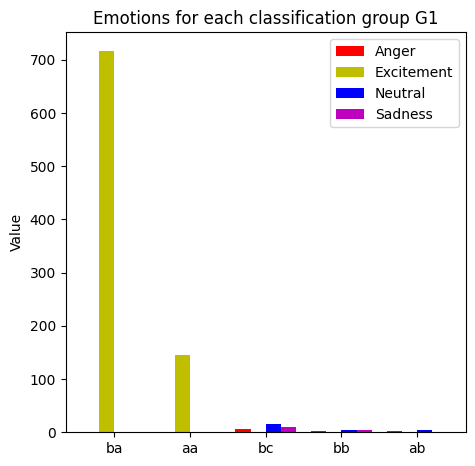

[763, 0, 1, 194, 0]


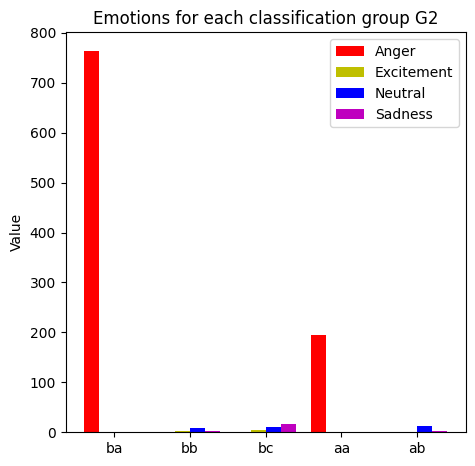

[15, 51, 24, 23, 14]


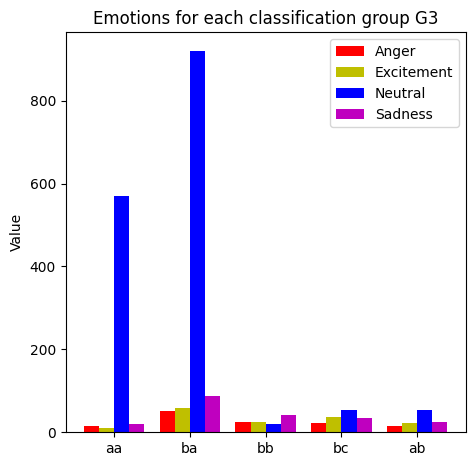

[0, 0, 1, 1, 4]


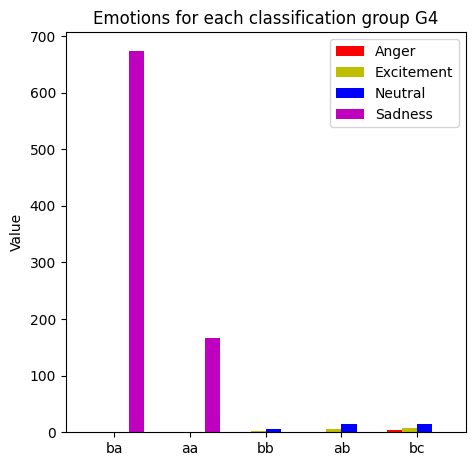

In [ ]:
test_group = all_kclusters['combined']
emotions_of_interest = get_emotion_per_cell(test_group)

print(emotions_of_interest)

for group_name in emotions_of_interest.keys():
  labels = []
  anger = []
  excitement = []
  neutral = []
  sadness = []
  group_dict = emotions_of_interest[group_name]
  X = np.arange(len(group_dict.keys()))
  fig = plt.figure()
  ax = fig.add_axes([0,0,1,1])
  for key in group_dict.keys():
    labels.append(key)
    anger.append(group_dict[key]['0'])
    excitement.append(group_dict[key]['1'])
    neutral.append(group_dict[key]['2'])
    sadness.append(group_dict[key]['3'])
  
  print(anger)

  ax.bar(X - 0.30, anger, color = 'r', width = 0.2)
  ax.bar(X - 0.10, excitement, color = 'y', width = 0.2)
  ax.bar(X + 0.10, neutral, color = 'b', width = 0.2)
  ax.bar(X + 0.30, sadness, color = 'm', width = 0.2)

  ax.set_ylabel('Value')
  ax.set_title('Emotions for each classification group ' + group_name)
  ax.set_xticks(X)
  ax.set_xticklabels(labels)
  ax.legend(labels=['Anger', 'Excitement', 'Neutral', 'Sadness'])
  plt.show()

## Combined 2 Example

{'G1': {'ba': defaultdict(<class 'int'>, {'3': 663}), 'aa': defaultdict(<class 'int'>, {'3': 175}), 'bb': defaultdict(<class 'int'>, {'2': 10, '3': 3, '0': 2, '1': 4}), 'ab': defaultdict(<class 'int'>, {'2': 9, '0': 1, '1': 1}), 'bc': defaultdict(<class 'int'>, {'1': 10, '0': 3, '2': 14, '3': 1})}, 'G2': {'ba': defaultdict(<class 'int'>, {'0': 741, '2': 1, '3': 1}), 'ab': defaultdict(<class 'int'>, {'3': 5, '2': 8, '1': 1}), 'bc': defaultdict(<class 'int'>, {'3': 7, '1': 5, '2': 13}), 'aa': defaultdict(<class 'int'>, {'0': 207, '2': 1}), 'bb': defaultdict(<class 'int'>, {'3': 4, '2': 6, '1': 2})}, 'G3': {'ba': defaultdict(<class 'int'>, {'1': 706}), 'aa': defaultdict(<class 'int'>, {'1': 149, '3': 1}), 'bc': defaultdict(<class 'int'>, {'3': 9, '2': 12, '0': 6}), 'ab': defaultdict(<class 'int'>, {'2': 10, '3': 2, '0': 2}), 'bb': defaultdict(<class 'int'>, {'1': 2, '0': 3, '3': 1, '2': 1})}, 'G4': {'aa': defaultdict(<class 'int'>, {'2': 499, '0': 15, '3': 24, '1': 11}), 'ba': defaultdict

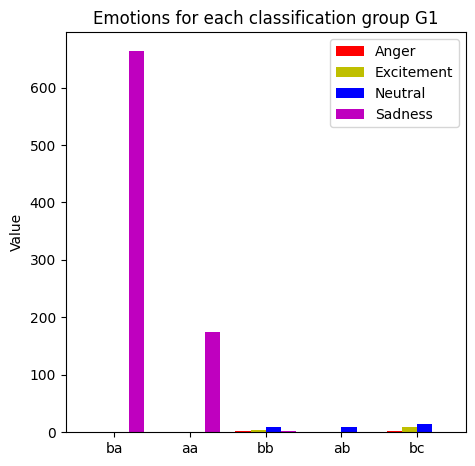

[741, 0, 0, 207, 0]


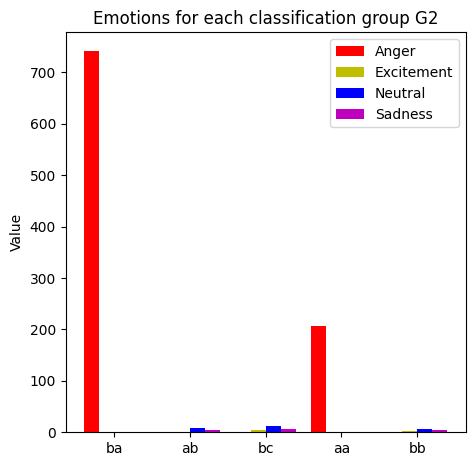

[0, 0, 6, 2, 3]


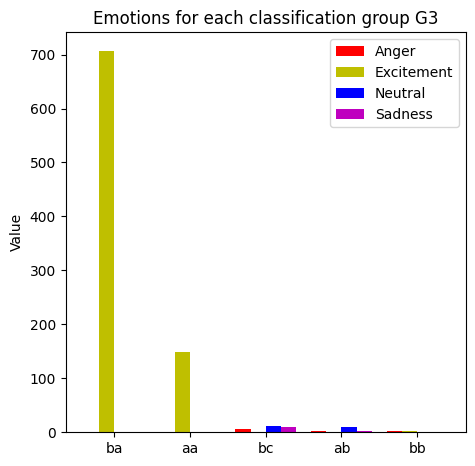

[15, 60, 25, 18, 20]


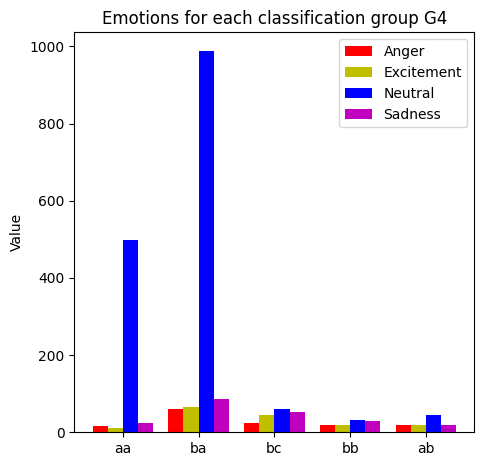

In [ ]:
test_group = all_kclusters['combined2']
emotions_of_interest = get_emotion_per_cell(test_group)

print(emotions_of_interest)

for group_name in emotions_of_interest.keys():
  labels = []
  anger = []
  excitement = []
  neutral = []
  sadness = []
  group_dict = emotions_of_interest[group_name]
  X = np.arange(len(group_dict.keys()))
  fig = plt.figure()
  ax = fig.add_axes([0,0,1,1])
  for key in group_dict.keys():
    labels.append(key)
    anger.append(group_dict[key]['0'])
    excitement.append(group_dict[key]['1'])
    neutral.append(group_dict[key]['2'])
    sadness.append(group_dict[key]['3'])
  
  print(anger)

  ax.bar(X - 0.30, anger, color = 'r', width = 0.2)
  ax.bar(X - 0.10, excitement, color = 'y', width = 0.2)
  ax.bar(X + 0.10, neutral, color = 'b', width = 0.2)
  ax.bar(X + 0.30, sadness, color = 'm', width = 0.2)

  ax.set_ylabel('Value')
  ax.set_title('Emotions for each classification group ' + group_name)
  ax.set_xticks(X)
  ax.set_xticklabels(labels)
  ax.legend(labels=['Anger', 'Excitement', 'Neutral', 'Sadness'])
  plt.show()

## Combined 4 Example

{'G1': {'aa': defaultdict(<class 'int'>, {'3': 1, '1': 211}), 'ba': defaultdict(<class 'int'>, {'1': 12, '0': 1}), 'bb': defaultdict(<class 'int'>, {}), 'bc': defaultdict(<class 'int'>, {})}, 'G2': {'aa': defaultdict(<class 'int'>, {'0': 339}), 'bc': defaultdict(<class 'int'>, {'2': 1, '3': 1}), 'bb': defaultdict(<class 'int'>, {'2': 2, '3': 1}), 'ba': defaultdict(<class 'int'>, {'0': 17})}, 'G3': {'aa': defaultdict(<class 'int'>, {'2': 1399, '0': 572, '3': 905, '1': 635}), 'ab': defaultdict(<class 'int'>, {'3': 122, '2': 142, '1': 110, '0': 48}), 'ba': defaultdict(<class 'int'>, {'2': 90, '0': 61, '3': 30, '1': 31}), 'bb': defaultdict(<class 'int'>, {'0': 5, '2': 27, '1': 18, '3': 12}), 'bc': defaultdict(<class 'int'>, {'0': 15, '2': 47, '3': 12, '1': 24})}, 'G4': {'aa': defaultdict(<class 'int'>, {'0': 44}), 'ba': defaultdict(<class 'int'>, {'0': 1}), 'bb': defaultdict(<class 'int'>, {}), 'bc': defaultdict(<class 'int'>, {})}}
[0, 1, 0, 0]


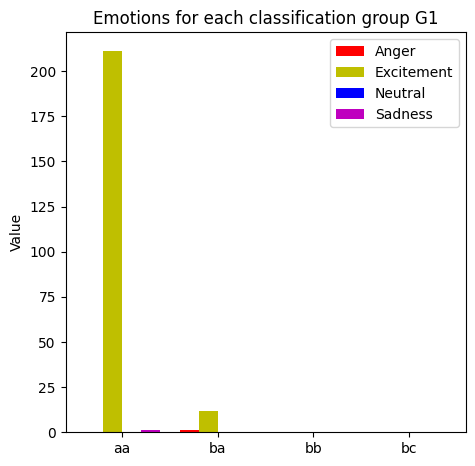

[339, 0, 0, 17]


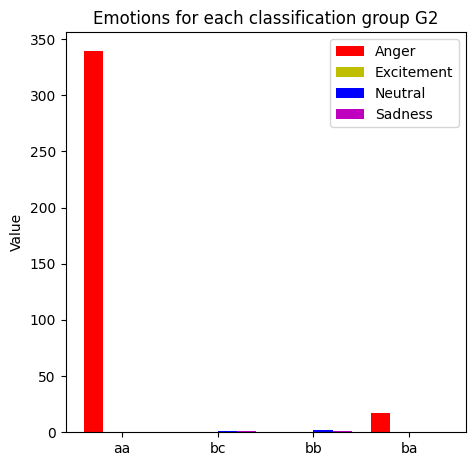

[572, 48, 61, 5, 15]


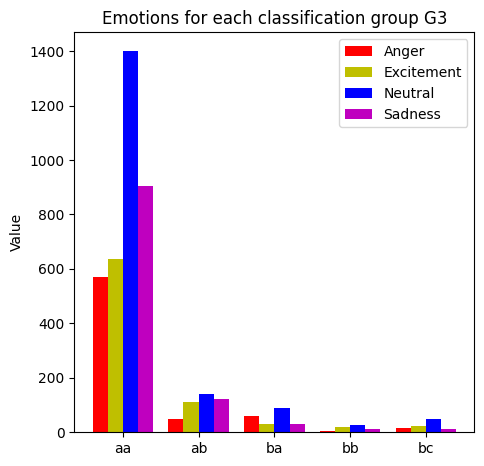

[44, 1, 0, 0]


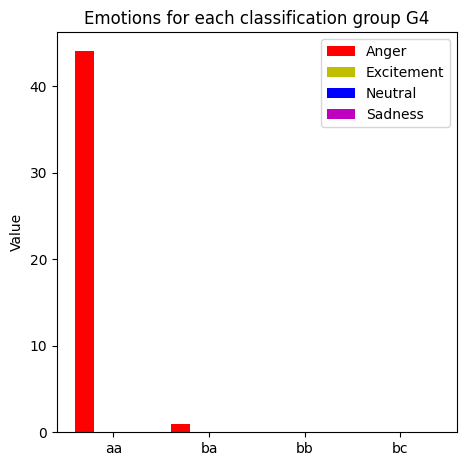

In [ ]:
test_group = all_kclusters['combined4']
emotions_of_interest = get_emotion_per_cell(test_group)

print(emotions_of_interest)

for group_name in emotions_of_interest.keys():
  labels = []
  anger = []
  excitement = []
  neutral = []
  sadness = []
  group_dict = emotions_of_interest[group_name]
  X = np.arange(len(group_dict.keys()))
  fig = plt.figure()
  ax = fig.add_axes([0,0,1,1])
  for key in group_dict.keys():
    labels.append(key)
    anger.append(group_dict[key]['0'])
    excitement.append(group_dict[key]['1'])
    neutral.append(group_dict[key]['2'])
    sadness.append(group_dict[key]['3'])
  
  print(anger)

  ax.bar(X - 0.30, anger, color = 'r', width = 0.2)
  ax.bar(X - 0.10, excitement, color = 'y', width = 0.2)
  ax.bar(X + 0.10, neutral, color = 'b', width = 0.2)
  ax.bar(X + 0.30, sadness, color = 'm', width = 0.2)

  ax.set_ylabel('Value')
  ax.set_title('Emotions for each classification group ' + group_name)
  ax.set_xticks(X)
  ax.set_xticklabels(labels)
  ax.legend(labels=['Anger', 'Excitement', 'Neutral', 'Sadness'])
  plt.show()

## Combined 5 Example

{'G1': {'aa': defaultdict(<class 'int'>, {'2': 1431, '0': 268, '3': 886, '1': 471}), 'ab': defaultdict(<class 'int'>, {'0': 71, '3': 121, '2': 108, '1': 107}), 'bb': defaultdict(<class 'int'>, {'2': 29, '0': 11, '3': 9, '1': 15}), 'bc': defaultdict(<class 'int'>, {'0': 25, '2': 37, '1': 23, '3': 10}), 'ba': defaultdict(<class 'int'>, {'2': 98, '3': 35, '1': 34, '0': 30})}, 'G2': {'aa': defaultdict(<class 'int'>, {'1': 28}), 'ba': defaultdict(<class 'int'>, {'1': 2}), 'bb': defaultdict(<class 'int'>, {}), 'bc': defaultdict(<class 'int'>, {})}, 'G3': {'aa': defaultdict(<class 'int'>, {'0': 663, '3': 3}), 'bc': defaultdict(<class 'int'>, {'2': 1, '3': 1}), 'ba': defaultdict(<class 'int'>, {'0': 33}), 'bb': defaultdict(<class 'int'>, {'2': 2}), 'ab': defaultdict(<class 'int'>, {'3': 1, '2': 1})}, 'G4': {'aa': defaultdict(<class 'int'>, {'1': 350, '3': 17}), 'ba': defaultdict(<class 'int'>, {'1': 11, '3': 1}), 'ab': defaultdict(<class 'int'>, {'2': 1, '0': 1}), 'bb': defaultdict(<class 'int

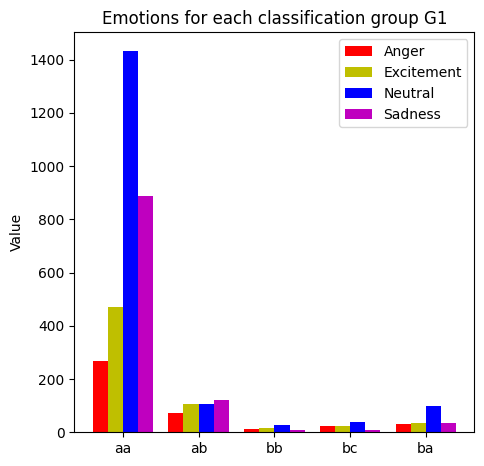

[0, 0, 0, 0]


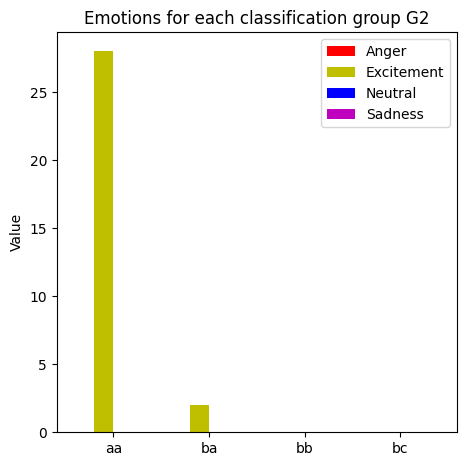

[663, 0, 33, 0, 0]


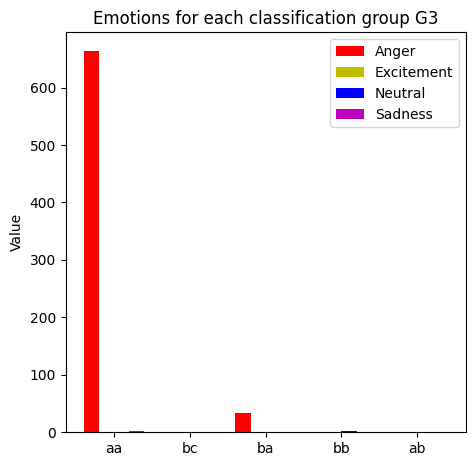

[0, 0, 1, 1, 0]


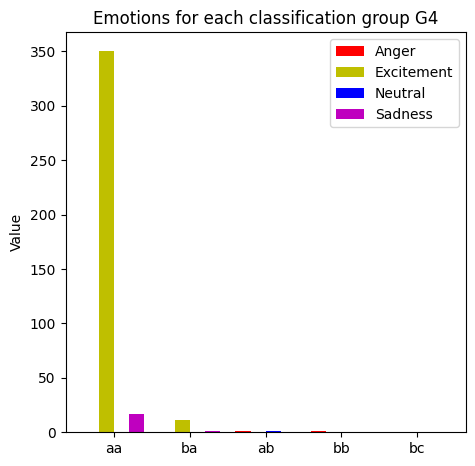

In [ ]:
test_group = all_kclusters['combined5']
emotions_of_interest = get_emotion_per_cell(test_group)

print(emotions_of_interest)

for group_name in emotions_of_interest.keys():
  labels = []
  anger = []
  excitement = []
  neutral = []
  sadness = []
  group_dict = emotions_of_interest[group_name]
  X = np.arange(len(group_dict.keys()))
  fig = plt.figure()
  ax = fig.add_axes([0,0,1,1])
  for key in group_dict.keys():
    labels.append(key)
    anger.append(group_dict[key]['0'])
    excitement.append(group_dict[key]['1'])
    neutral.append(group_dict[key]['2'])
    sadness.append(group_dict[key]['3'])
  
  print(anger)

  ax.bar(X - 0.30, anger, color = 'r', width = 0.2)
  ax.bar(X - 0.10, excitement, color = 'y', width = 0.2)
  ax.bar(X + 0.10, neutral, color = 'b', width = 0.2)
  ax.bar(X + 0.30, sadness, color = 'm', width = 0.2)

  ax.set_ylabel('Value')
  ax.set_title('Emotions for each classification group ' + group_name)
  ax.set_xticks(X)
  ax.set_xticklabels(labels)
  ax.legend(labels=['Anger', 'Excitement', 'Neutral', 'Sadness'])
  plt.show()

## LSTM Multimodal

In [ ]:
def construct_deep_classifier():
  model = Sequential()
  model.add(Dense(1024, activation='relu', input_shape=(None, 1024)))
  model.add(Dropout(0.2))
  model.add(Dense(1024, activation='relu', name='embedding_layer'))
  model.add(Dropout(0.2))
  model.add(Dense(4, activation='softmax'))

  model.compile(loss='categorical_crossentropy',optimizer='adam' ,metrics=['acc'])
  model.summary()

  return model

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, None, 1024)        1049600   
_________________________________________________________________
dropout_16 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
embedding_layer (Dense)      (None, None, 1024)        1049600   
_________________________________________________________________
dropout_17 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
dense_9 (Dense)              (None, None, 4)           4100      
Total params: 2,103,300
Trainable params: 2,103,300
Non-trainable params: 0
_________________________________________________________________
4443
4443
[0.5695277  0.         0.27028066 ... 0.1304331  0.02929651 0.        ]
Epoch 1/100
63/63 [=========

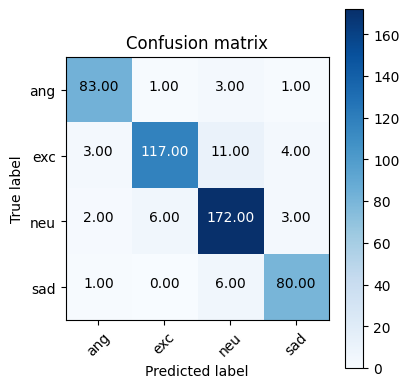

In [ ]:
combined_model_lstm = construct_deep_classifier()

print(len(embeddings_train_lstm))
print(len(labels_train_lstm))
print(embeddings_train_lstm[0])

embeddings_train_lstm = tf.stack(embeddings_train_lstm)
labels_train_lstm = tf.stack(labels_train_lstm)
embeddings_test_lstm = tf.stack(embeddings_test_lstm)
labels_test_lstm = tf.stack(labels_test_lstm)

hist = combined_model_lstm.fit(embeddings_train_lstm, labels_train_lstm, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = combined_model_lstm.evaluate(embeddings_test_lstm, labels_test_lstm, verbose=1)

print("[INFO] evaluating network...")
predictions = combined_model_lstm.predict(x=embeddings_test_lstm, batch_size=64)
print(classification_report(labels_test_lstm.numpy().argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(labels_test_lstm.numpy().argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

## Combined Multimodal

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, None, 1024)        1049600   
_________________________________________________________________
dropout_18 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
embedding_layer (Dense)      (None, None, 1024)        1049600   
_________________________________________________________________
dropout_19 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
dense_11 (Dense)             (None, None, 4)           4100      
Total params: 2,103,300
Trainable params: 2,103,300
Non-trainable params: 0
_________________________________________________________________
4443
4443
1024
Epoch 1/100
63/63 [==============================] - 1s 6ms/step - loss: 0.5848 - acc: 0.8141 -

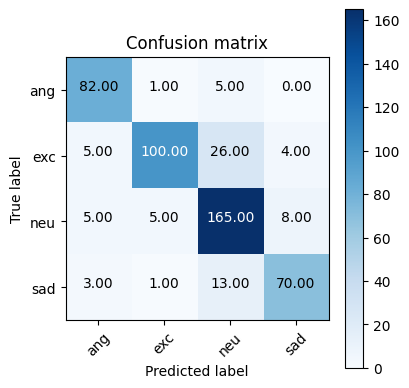

In [ ]:
combined_model_com = construct_deep_classifier()

print(len(embeddings_train_combined))
print(len(labels_train_combined))
print(len(embeddings_train_combined[0]))

embeddings_train_combined = tf.stack(embeddings_train_combined)
labels_train_combined = tf.stack(labels_train_combined)
embeddings_test_combined = tf.stack(embeddings_test_combined)
labels_test_combined = tf.stack(labels_test_combined)

hist = combined_model_com.fit(embeddings_train_combined, labels_train_combined, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = combined_model_com.evaluate(embeddings_test_combined, labels_test_combined, verbose=1)

print("[INFO] evaluating network...")
predictions = combined_model_com.predict(x=embeddings_test_combined, batch_size=64)
print(classification_report(labels_test_combined.numpy().argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(labels_test_combined.numpy().argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

## Combined 2 Multimodal

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_12 (Dense)             (None, None, 1024)        1049600   
_________________________________________________________________
dropout_20 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
embedding_layer (Dense)      (None, None, 1024)        1049600   
_________________________________________________________________
dropout_21 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
dense_13 (Dense)             (None, None, 4)           4100      
Total params: 2,103,300
Trainable params: 2,103,300
Non-trainable params: 0
_________________________________________________________________
4443
4443
1024
Epoch 1/100
63/63 [==============================] - 1s 5ms/step - loss: 0.6225 - acc: 0.8027 -

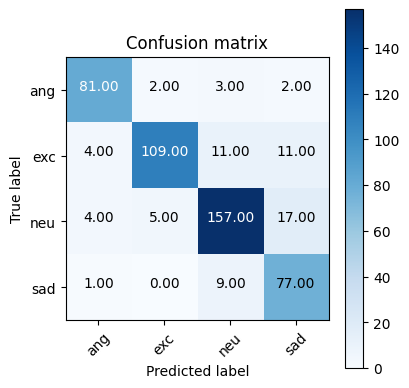

In [ ]:
combined_model_com2 = construct_deep_classifier()


print(len(embeddings_train_combined2))
print(len(labels_train_combined2))
print(len(embeddings_train_combined2[0]))

embeddings_train_combined2 = tf.stack(embeddings_train_combined2)
labels_train_combined2 = tf.stack(labels_train_combined2)
embeddings_test_combined2 = tf.stack(embeddings_test_combined2)
labels_test_combined2 = tf.stack(labels_test_combined2)

hist = combined_model_com2.fit(embeddings_train_combined2, labels_train_combined2, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = combined_model_com2.evaluate(embeddings_test_combined2, labels_test_combined2, verbose=1)

print("[INFO] evaluating network...")
predictions = combined_model_com2.predict(x=embeddings_test_combined2, batch_size=64)
print(classification_report(labels_test_combined2.numpy().argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(labels_test_combined2.numpy().argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

## Combined 4 Multimodal

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_14 (Dense)             (None, None, 1024)        1049600   
_________________________________________________________________
dropout_22 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
embedding_layer (Dense)      (None, None, 1024)        1049600   
_________________________________________________________________
dropout_23 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
dense_15 (Dense)             (None, None, 4)           4100      
Total params: 2,103,300
Trainable params: 2,103,300
Non-trainable params: 0
_________________________________________________________________
4443
4443
1024
Epoch 1/100
63/63 [==============================] - 1s 5ms/step - loss: 1.2135 - acc: 0.8052 -

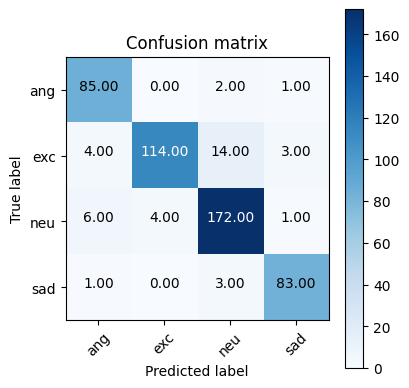

In [ ]:
combined_model_com4 = construct_deep_classifier()


print(len(embeddings_train_combined4))
print(len(labels_train_combined4))
print(len(embeddings_train_combined4[0]))

embeddings_train_combined4 = tf.stack(embeddings_train_combined4)
labels_train_combined4 = tf.stack(labels_train_combined4)
embeddings_test_combined4 = tf.stack(embeddings_test_combined4)
labels_test_combined4 = tf.stack(labels_test_combined4)

hist = combined_model_com4.fit(embeddings_train_combined4, labels_train_combined4, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = combined_model_com4.evaluate(embeddings_test_combined4, labels_test_combined4, verbose=1)

print("[INFO] evaluating network...")
predictions = combined_model_com4.predict(x=embeddings_test_combined4, batch_size=64)
print(classification_report(labels_test_combined4.numpy().argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(labels_test_combined4.numpy().argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)

## Combined 5 Multimodal

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, None, 1024)        1049600   
_________________________________________________________________
dropout_24 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
embedding_layer (Dense)      (None, None, 1024)        1049600   
_________________________________________________________________
dropout_25 (Dropout)         (None, None, 1024)        0         
_________________________________________________________________
dense_17 (Dense)             (None, None, 4)           4100      
Total params: 2,103,300
Trainable params: 2,103,300
Non-trainable params: 0
_________________________________________________________________
4443
4443
1024
Epoch 1/100
63/63 [==============================] - 1s 5ms/step - loss: 0.5547 - acc: 0.8634 

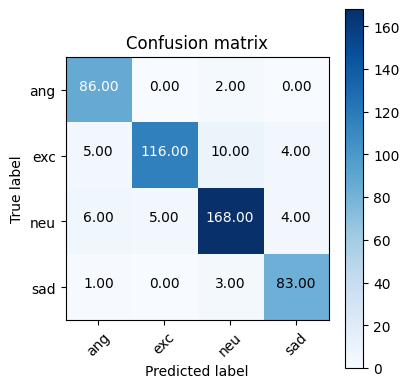

In [ ]:
combined_model_com5 = construct_deep_classifier()


print(len(embeddings_train_combined5))
print(len(labels_train_combined5))
print(len(embeddings_train_combined5[0]))

embeddings_train_combined5 = tf.stack(embeddings_train_combined5)
labels_train_combined5 = tf.stack(labels_train_combined5)
embeddings_test_combined5 = tf.stack(embeddings_test_combined5)
labels_test_combined5 = tf.stack(labels_test_combined5)

hist = combined_model_com5.fit(embeddings_train_combined5, labels_train_combined5, 
                 batch_size=64, epochs=100, verbose=1, 
                 validation_split=0.1)

_, acc = combined_model_com2.evaluate(embeddings_test_combined5, labels_test_combined5, verbose=1)

print("[INFO] evaluating network...")
predictions = combined_model_com5.predict(x=embeddings_test_combined5, batch_size=64)
print(classification_report(labels_test_combined5.numpy().argmax(axis=1),
	predictions.argmax(axis=1), target_names=emotions_used))

cm = confusion_matrix(labels_test_combined5.numpy().argmax(axis=1),
	predictions.argmax(axis=1))
plot_confusion_matrix(cm, emotions_used)